Figs. 2 and 3: Delineating fate choice in pancreatic development / Zooming into the delta state to elucidate differentiation paths
----
Apply CellRank to the pancreas data example to show its main features in action. Focus on the rare delta cell population and show how cellrank can be used to identify the trajectory as well as associated genes.

Notes
- There is a minor bug with figure saving in scVelo 0.2.4, see this [issue](https://github.com/theislab/scvelo/issues/707). That's why you see some scattered `scv.settings.figdir` expressions.  

# Preliminaries

## Dependecy notebooks

Note: We use MAGIC imputed data and the Palantir pseudotime here which have been computed in the `fig_5_benchmarking/palantir` directory. Palantir's pseudotime is available in the `.obs` attribute of our pancreas example dataset. MAGIC imputed data is available from 
[Figshare](https://ndownloader.figshare.com/files/25120526?private_link=7e192d9821165855eaff0). 

## Import packages

In [1]:
# import standard packages
import numpy as np
import pandas as pd 

import matplotlib.pyplot as plt
import seaborn as sns

import os
import sys
from typing import Optional

# import single-cell packages
import scanpy as sc
import scanpy.external as sce
import scvelo as scv
import cellrank as cr
from anndata import AnnData

# utility
from cellrank.tl._utils import _merge_categorical_series

# set verbosity levels
sc.settings.verbosity = 2
cr.settings.verbosity = 2
scv.settings.verbosity = 3 

## Print package versions for reproducibility

If you want to exactly reproduce the results shown here, please make sure that your package versions match what is printed below. 

In [2]:
cr.logging.print_versions()

cellrank==1.5.0+g65f1562 scanpy==1.8.1 anndata==0.7.6 numpy==1.20.3 numba==0.54.0 scipy==1.7.1 pandas==1.3.3 pygpcca==1.0.2 scikit-learn==0.24.2 statsmodels==0.13.0rc0 python-igraph==0.9.1 scvelo==0.2.4 pygam==0.8.0 matplotlib==3.4.3 seaborn==0.11.2


Show when this notebook was executed last:

In [3]:
cr.logging.print_version_and_date()

Running CellRank 1.5.0+g65f1562, on 2021-10-26 14:40.


## Set up paths

Define the paths to load data, cache results and write figure panels.

In [4]:
sys.path.insert(0, "../..")  # this depends on the notebook depth and must be adapted per notebook

from paths import DATA_DIR, CACHE_DIR, FIG_DIR

Set up the paths to save figures.

In [5]:
scv.settings.figdir = str(FIG_DIR)
sc.settings.figdir = str(FIG_DIR)
cr.settings.figdir = str(FIG_DIR)

## Set up caching

Note: we use a caching extension called `scachepy` for this analysis, see [here](https://github.com/theislab/scachepy). We do this to speed up the runtime of this notebook by avoiding the most expensive computations. Below, we check whether you have scachepy installed and if you don't, then we automatically recompute all results. 

In [6]:
try:
    import scachepy
    c = scachepy.Cache(CACHE_DIR / "pancreas", separate_dirs=True)
    print('Sucessfully imported scachepy. Expensive computations will be cached. ')
except ImportError:
    c = None
    print('Failed to import scachepy. Consider installing it from `https://github.com/theislab/scachepy`. ')
use_caching = c is not None
c

Sucessfully imported scachepy. Expensive computations will be cached. 


Cache(root=/Users/marius/Projects/cellrank_reproducibility_2/cache/pancreas, ext='.pickle', compression='None')

## Set global parameters

Set some plotting parameters.

In [7]:
scv.settings.set_figure_params('scvelo', dpi_save=400, dpi=80, transparent=True, fontsize=20, color_map='viridis')
scv.settings.plot_prefix = ""

Set other global parameters

In [8]:
# should figures just be displayed or also saved?
save_figure = True

# should cashed values be used, or recompute?
force_recompute = False

If there are other global parameters for this analysis, put them here as well. 

## Define utility functions

In [9]:
def _create_initial_terminal_annotations(
    adata: AnnData,
    terminal_key: str = "terminal_states",
    initial_key: str = "initial_states",
    terminal_prefix: Optional[str] = "terminal",
    initial_prefix: Optional[str] = "initial",
    key_added: Optional[str] = "initial_terminal",
) -> None:
    """
    Create categorical annotations of both initial and terminal states.
    
    This is a utility function for creating a categorical :class:`pandas.Series` object which combines
    the information about initial and terminal states. The :class:`pandas.Series` is written directly
    to the :class:`anndata.AnnData`object. This can for example be used to create a scatter plot in :mod:`scvelo`.
    Parameters
    ----------
    adata
        AnnData object to write to ``.obs[key_added]``.
    terminal_key
        Key from ``adata.obs`` where terminal states have been saved.
    initial_key
        Key from ``adata.obs`` where initial states have been saved.
    terminal_prefix
        Forward direction prefix used in the annotations.
    initial_prefix
        Backward direction prefix used in the annotations.
    key_added
        Key added to ``adata.obs``.
    Returns
    -------
    None
        Nothing, just writes to ``adata``.
    """

    # get both Series objects
    cats_final, colors_final = (
        adata.obs[terminal_key],
        adata.uns[f"{terminal_key}_colors"],
    )
    cats_root, colors_root = adata.obs[initial_key], adata.uns[f"{initial_key}_colors"]

    # merge
    cats_merged, colors_merged = _merge_categorical_series(
        cats_final,
        cats_root,
        colors_old=list(colors_final),
        colors_new=list(colors_root),
    )

    # adjust the names
    final_names = cats_final.cat.categories
    final_labels = [
        f"{terminal_prefix if key in final_names else initial_prefix}: {key}"
        for key in cats_merged.cat.categories
    ]
    cats_merged = cats_merged.cat.rename_categories(final_labels)

    # write to AnnData
    adata.obs[key_added] = cats_merged
    adata.uns[f"{key_added}_colors"] = colors_merged

## Load the data

Load the AnnData object from the CellRank software package. 

In [10]:
adata = cr.datasets.pancreas(DATA_DIR / "pancreas" / "pancreas.h5ad")
adata

AnnData object with n_obs × n_vars = 2531 × 27998
    obs: 'day', 'proliferation', 'G2M_score', 'S_score', 'phase', 'clusters_coarse', 'clusters', 'clusters_fine', 'louvain_Alpha', 'louvain_Beta', 'palantir_pseudotime'
    var: 'highly_variable_genes'
    uns: 'clusters_colors', 'clusters_fine_colors', 'day_colors', 'louvain_Alpha_colors', 'louvain_Beta_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    layers: 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

Show proportions using scVelo

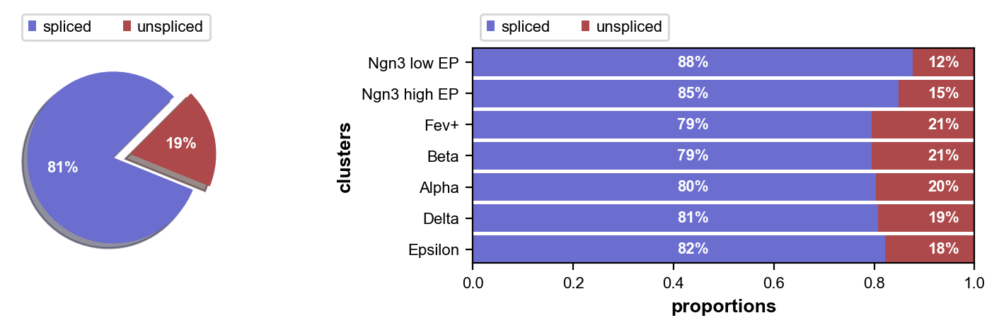

In [11]:
scv.pl.proportions(adata)

Additionally, load the MAGIC imputed data which we will need later on for gene trend plotting. MAGIC imputed data is available from 
[Figshare](https://ndownloader.figshare.com/files/25120526?private_link=7e192d9821165855eaff0). 

In [12]:
magic_imputed_data = pd.read_csv(DATA_DIR / "pancreas" / "pancreas_magic_imputed_data.csv", index_col=0)

# Compute and analyze velocities using scVelo

## Plot raw count distribution

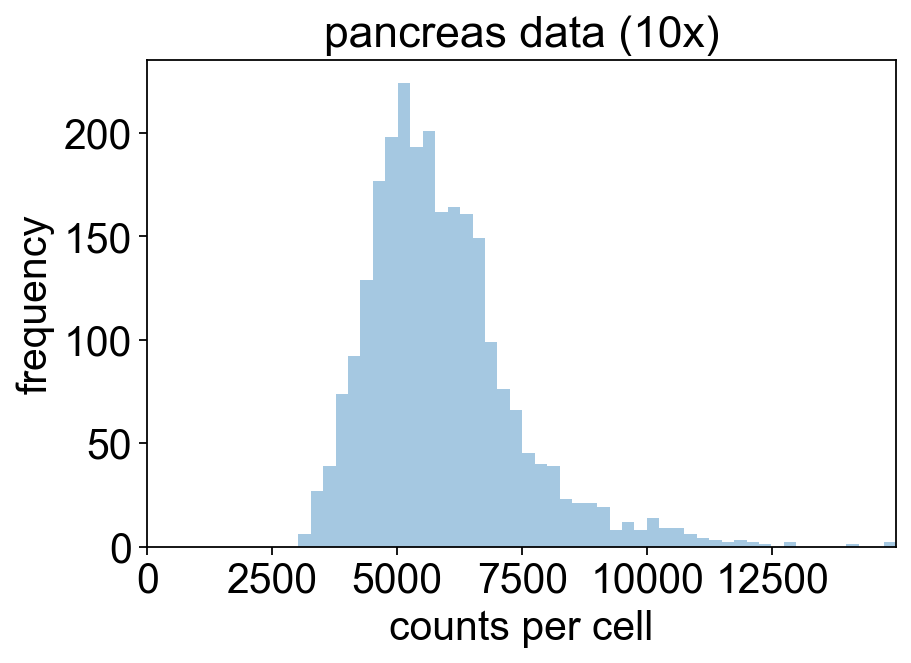

In [13]:
total_counts = adata.X.sum(1)
ax = sns.distplot(total_counts, kde=False)
ax.set_xlabel('counts per cell')
ax.set_ylabel('frequency')
ax.set_xlim([0, total_counts.max()])
ax.set_title('pancreas data (10x)')

plt.show()

## Pre-process the data

We'll process the data in .raw a bit differently becasue we need more genes for trend plotting. 

### Raw data (for plotting)

We will use this object for gene trend plotting further down. 

In [14]:
adata_raw = adata.copy()
sc.pp.filter_genes(adata_raw, min_cells=10)
scv.pp.normalize_per_cell(adata_raw)
sc.pp.log1p(adata_raw)

# annotate highly variable genes, but don't filter them out
sc.pp.highly_variable_genes(adata_raw)
print(f"This detected {np.sum(adata_raw.var['highly_variable'])} highly variable genes. ")
adata.raw = adata_raw

filtered out 15011 genes that are detected in less than 10 cells
Normalized count data: X, spliced, unspliced.
extracting highly variable genes
    finished (0:00:01)
This detected 1480 highly variable genes. 


Add the MAGIC imputed data to the raw AnnData object, making sure that the order of cells and genes is correct. 

In [15]:
assert(adata_raw.shape == magic_imputed_data.shape), "Shape mismatch between AnnData and MAGIC imputed data"
adata_raw.layers['magic_imputed_data'] = magic_imputed_data[adata_raw.var_names].loc[adata_raw.obs_names]

### Data for velocity computation

In [16]:
# filter, normalise, log transform
scv.pp.filter_and_normalize(adata, min_shared_counts=20, log=True, n_top_genes=2000)

# compute pca, knn graph and scvelo's moments
sc.tl.pca(adata)
sc.pp.neighbors(adata, n_pcs=30, n_neighbors=30)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)

Filtered out 22024 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished (0:00:13)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


## Visualize annotations and cell type composition

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_annotations/annotation_clusters.pdf


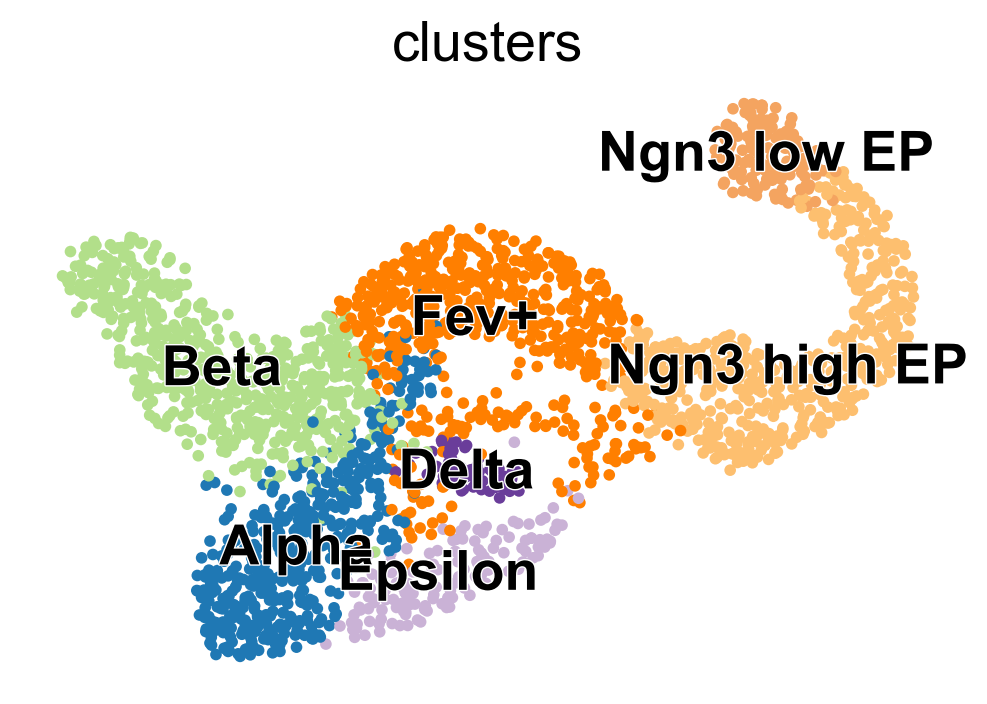

In [17]:
fig_kwargs = {'color': 'clusters', 'dpi': 100, 'legend_loc': 'on data', 's': 70}
# if save_figure: fig_kwargs['save'] = "suppl_figures_pancreas/suppl_fig_annotations/annotation_clusters.pdf"
if save_figure: fig_kwargs['save'] =  scv.settings.figdir + "/suppl_figures_pancreas/suppl_fig_annotations/annotation_clusters.pdf"
scv.pl.scatter(adata, **fig_kwargs)

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_annotations/annotations_clusters_fine.pdf


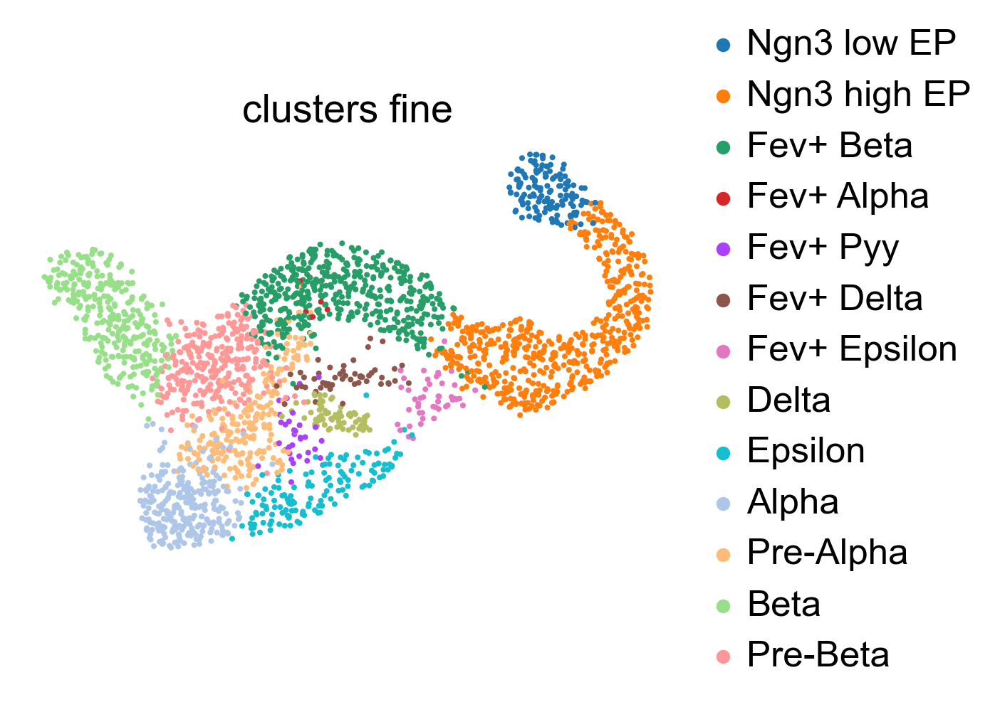

In [18]:
fig_kwargs = {'color': 'clusters_fine', 'dpi': 100, 'legend_loc': 'right'}
if save_figure: fig_kwargs['save'] = scv.settings.figdir +"suppl_figures_pancreas/suppl_fig_annotations/annotations_clusters_fine.pdf"
scv.pl.scatter(adata, **fig_kwargs)

Show the fine cluster annotations, restricted to Fev+ cells:

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_annotations/fev+.pdf


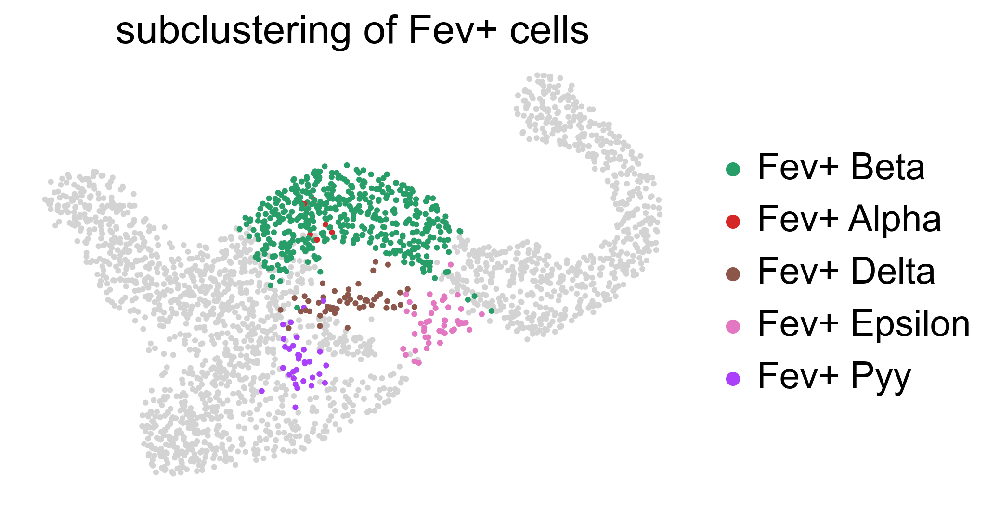

In [19]:
fig_kwargs = {'color': 'clusters_fine', 
                'legend_loc': 'right', 
                'groups': ['Fev+ Beta', 'Fev+ Alpha', 'Fev+ Delta','Fev+ Epsilon', 'Fev+ Pyy'],
                'title': 'subclustering of Fev+ cells', 
                 'dpi': 150,
                }
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'suppl_figures_pancreas/suppl_fig_annotations/fev+.pdf'
scv.pl.scatter(adata, **fig_kwargs)

Show a pie chart of the cell type composition here: 

There are 70 Delta cells in the data


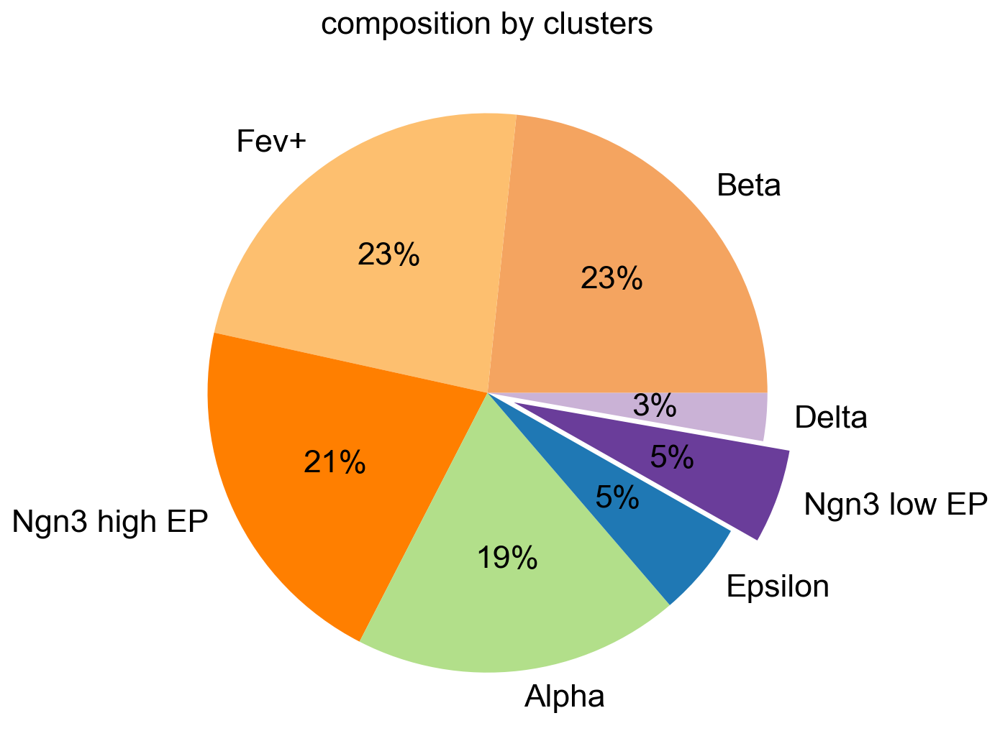

In [20]:
clusters = adata.obs['clusters'].cat.categories
explode = np.zeros(len(clusters))
mask = (clusters == 'Delta')
explode[mask] = 0.1

fig_kwargs = {'key': 'clusters', 'autopct': '%1.0f%%', 'explode': explode, 'figsize': (8, 8)}
if save_figure: fig_kwargs['save'] = "suppl_figures_pancreas/suppl_fig_annotations/clusters_composition.pdf"
cr.pl._utils.composition(adata, **fig_kwargs)

# print absolute number of Delta cells
print(f"There are {np.sum(adata.obs['clusters'] == 'Delta')} Delta cells in the data")

## Visualise marker gene expression

The following genes correspond either to hormones (terminal populations) or mark ductal cells (initial population):

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_annotations/initial_terminal_markers.pdf


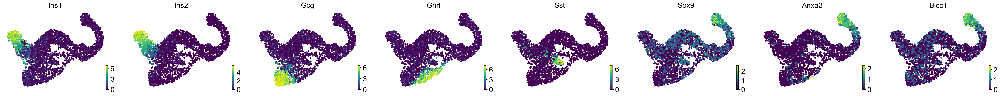

In [21]:
state_markers = ['Ins1', 'Ins2', 'Gcg', 'Ghrl', 'Sst', 'Sox9', 'Anxa2', 'Bicc1']
fig_kwargs = {'color': state_markers, 'size': 100}
if save_figure: fig_kwargs['save'] = scv.settings.figdir +'suppl_figures_pancreas/suppl_fig_annotations/initial_terminal_markers.pdf'
scv.pl.scatter(adata_raw, **fig_kwargs)

## Compute velocities using scVelo

In [22]:
# compute/load from cache the dyn. model params and compute velocities
n_jobs = 8

if use_caching:
    c.tl.recover_dynamics(adata, fname='2021-09-21_recover_dynamics', force=force_recompute, n_jobs=n_jobs)
else:
    scv.tl.recover_dynamics(adata, n_jobs=n_jobs)
    
scv.tl.velocity(adata, mode='dynamical')

Loading data from: `2021-09-21_recover_dynamics.pickle`.
computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


## Project velocities onto the embedding

Often, we want to show velocities in the UMAP embedding here.

computing velocity graph (using 1/8 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/fig_2_pancreas_main/velocities_umap.pdf


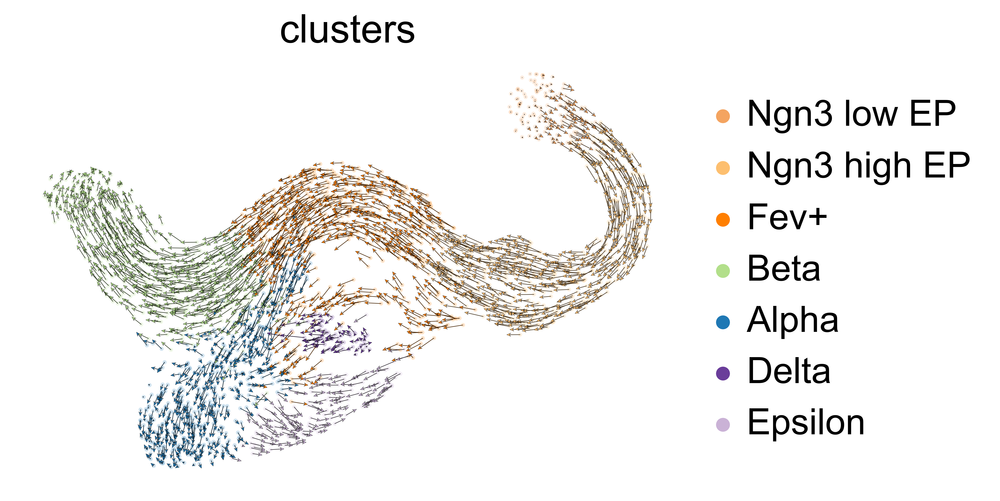

In [23]:
scv.tl.velocity_graph(adata)

fig_kwargs = {'color': ['clusters'],
                 'legend_loc': 'right', 'scale': 0.1, 'dpi': 400}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'fig_2_pancreas_main/velocities_umap.pdf'
scv.pl.velocity_embedding(adata, **fig_kwargs)

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/fig_2_pancreas_main/velocities_umap_streamlines.png


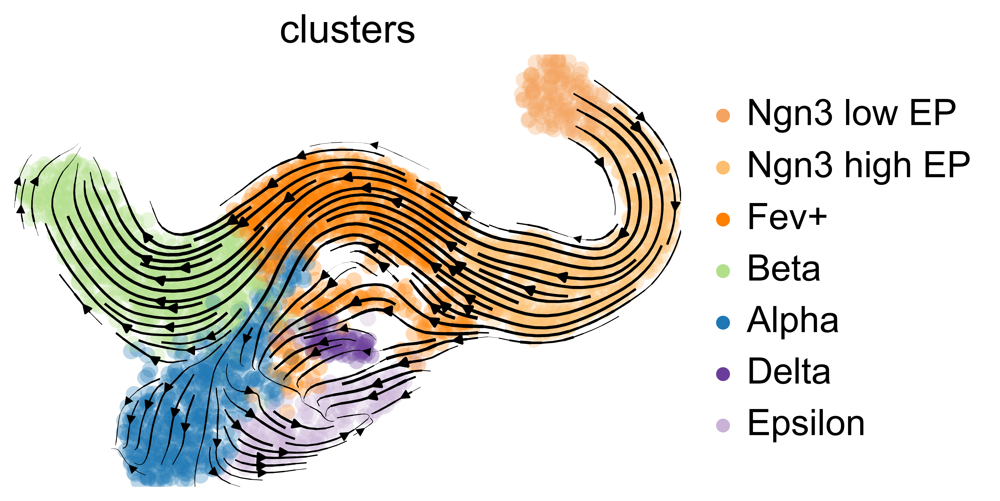

In [24]:
fig_kwargs = {'color': ['clusters'],
                 'legend_loc': 'right', 'dpi': 600}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'fig_2_pancreas_main/velocities_umap_streamlines.png'
scv.pl.velocity_embedding_stream(adata, **fig_kwargs)

## Look into gene-wise velocities

Look into the genes and mostly driver these velocities

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_velocity_genes/0_to_20.pdf


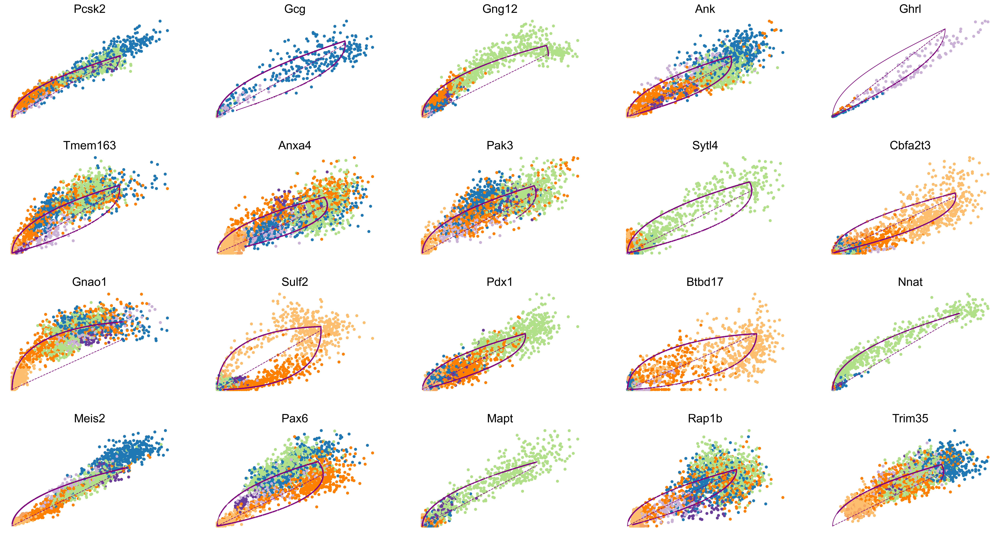

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_velocity_genes/20_to_30.pdf


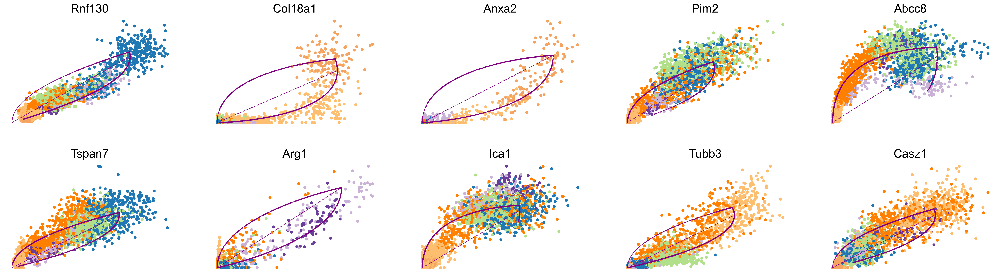

In [25]:
high_likelihood_genes = adata.var.sort_values('fit_likelihood', ascending=False).index

# plot the first 20 genes
fig_kwargs = {'basis': high_likelihood_genes[:20], 'frameon': False, 'ncols': 5, 's': 100, 'dpi': 150}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'suppl_figures_pancreas/suppl_fig_velocity_genes/0_to_20.pdf'
scv.pl.scatter(adata, **fig_kwargs)

# plot the remaining genes
fig_kwargs = {'basis': high_likelihood_genes[20:30], 'frameon': False, 'ncols': 5, 's': 100, 'dpi': 150}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'suppl_figures_pancreas/suppl_fig_velocity_genes/20_to_30.pdf'
scv.pl.scatter(adata, **fig_kwargs)

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_velocity_genes/known_delta_drivers.pdf


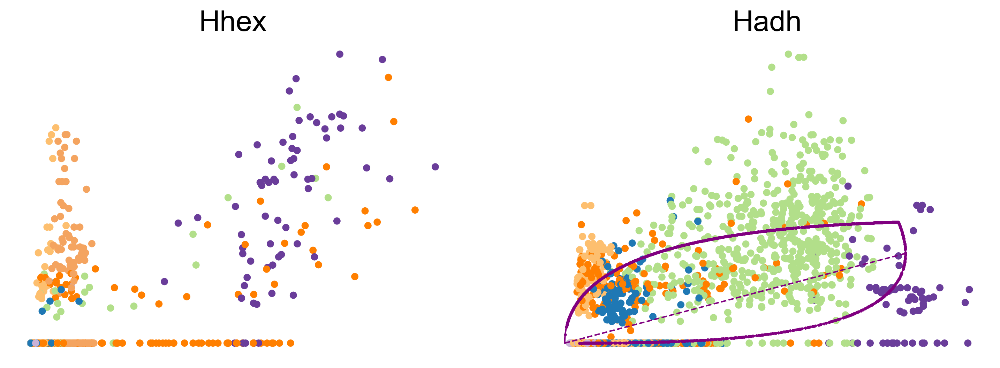

In [26]:
fig_kwargs = {'basis': ['Hhex', 'Hadh', 'Cd24a'], 'frameon': False, 's': 100, 'dpi': 150}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'suppl_figures_pancreas/suppl_fig_velocity_genes/known_delta_drivers.pdf' 
scv.pl.scatter(adata, **fig_kwargs)

Show spliced/unspliced counts for Cd24a - that's a gene that does not make it through scVelo's filtering threshold becasue it does not have enough unspliced counts:

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_velocity_genes/cd24a_s_u_expression.pdf


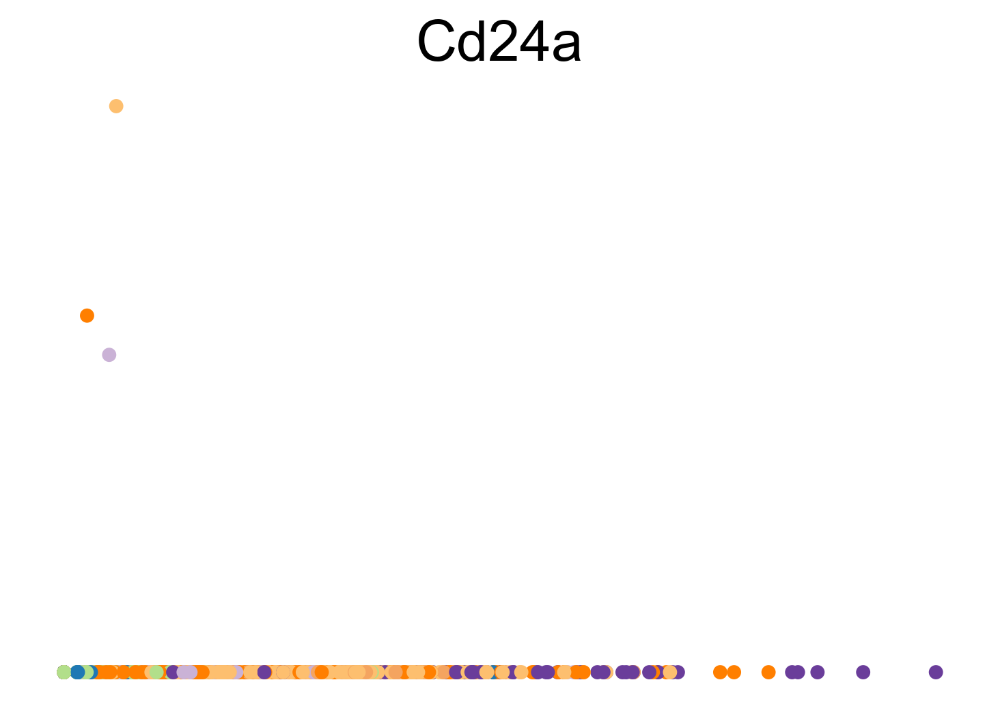

In [27]:
fig_kwargs = {'basis': [ 'Cd24a'], 'frameon': False, 's': 100, 'dpi': 150}
if save_figure: fig_kwargs['save'] = scv.settings.figdir +'suppl_figures_pancreas/suppl_fig_velocity_genes/cd24a_s_u_expression.pdf' 
scv.pl.scatter(adata_raw, **fig_kwargs)

In [28]:
print(f"Cd24a has unspliced counts in {(adata_raw[:, 'Cd24a'].layers['unspliced'] > 0).sum()}/{adata.n_obs} cells.")
print(f"Cd24a has spliced counts in {(adata_raw[:, 'Cd24a'].layers['spliced'] > 0).sum()}/{adata.n_obs} cells.")

Cd24a has unspliced counts in 3/2531 cells.
Cd24a has spliced counts in 1563/2531 cells.


# Run CellRank (Fig. 2)

## Initialise kernel and estimator

This serves as an example of how to cach a transition matrix and of the default values we should be using. 

In [29]:
from cellrank.tl.estimators import GPCCA

# set the parameters we want to use to compute the transition matrix
weight_connectivities=0.2
mode="stochastic" 
n_jobs=8
softmax_scale=None

if use_caching:
    c.tl.transition_matrix(adata, 
                           weight_connectivities=weight_connectivities, 
                           mode=mode, 
                           n_jobs=n_jobs, 
                           softmax_scale=softmax_scale, 
                           fname='2021-09-21_transition_matrix_stochastic', 
                           force=force_recompute)
    g_fwd = GPCCA(adata, obsp_key='T_fwd')
else:
    kernel = cr.tl.transition_matrix(adata, 
                                     weight_connectivities=weight_connectivities, 
                                     mode=mode, 
                                     n_jobs=n_jobs, 
                                     softmax_scale=softmax_scale)
    g_fwd = GPCCA(kernel)
    
print(g_fwd)

Loading data from: `2021-09-21_transition_matrix_stochastic.pickle`.
GPCCA[n=2531, kernel=<PrecomputedKernel[origin=adata.obsp['T_fwd']]>]


## Print transition matrix statistics for reproducibility

To make sure that we're using the same transition matrix, show some stats. 

In [30]:
# just for consistency, display some summary staes about the transition matrix
T = adata.obsp['T_fwd']
T_med, T_mean, T_var = np.median(T.data), np.mean(T.data), np.var(T.data)
T_min, T_max = np.min(T.data), np.max(T.data)

print(f'med = {T_med:.6f},\nmean = {T_mean:.6f},\nvar = {T_var:.6f},\nmin = {T_min:.6f},\nmax = {T_max:.6f}')

med = 0.018982,
mean = 0.024591,
var = 0.000451,
min = 0.000067,
max = 0.408090


## Compute the real Schur decomposition

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[6, 9, 13, 15, 17]`
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:10)


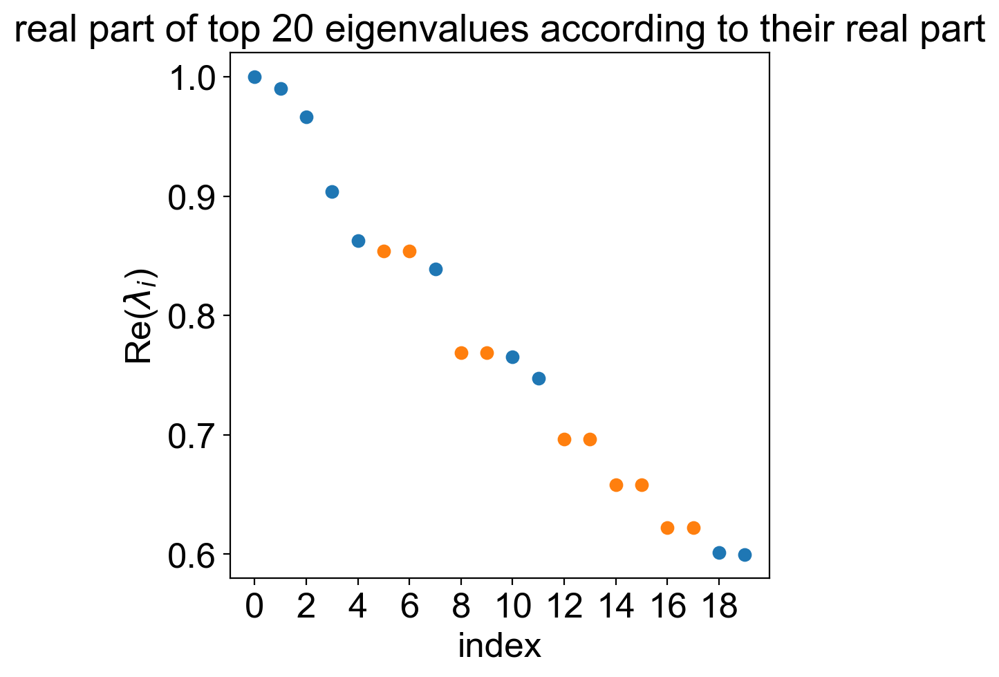

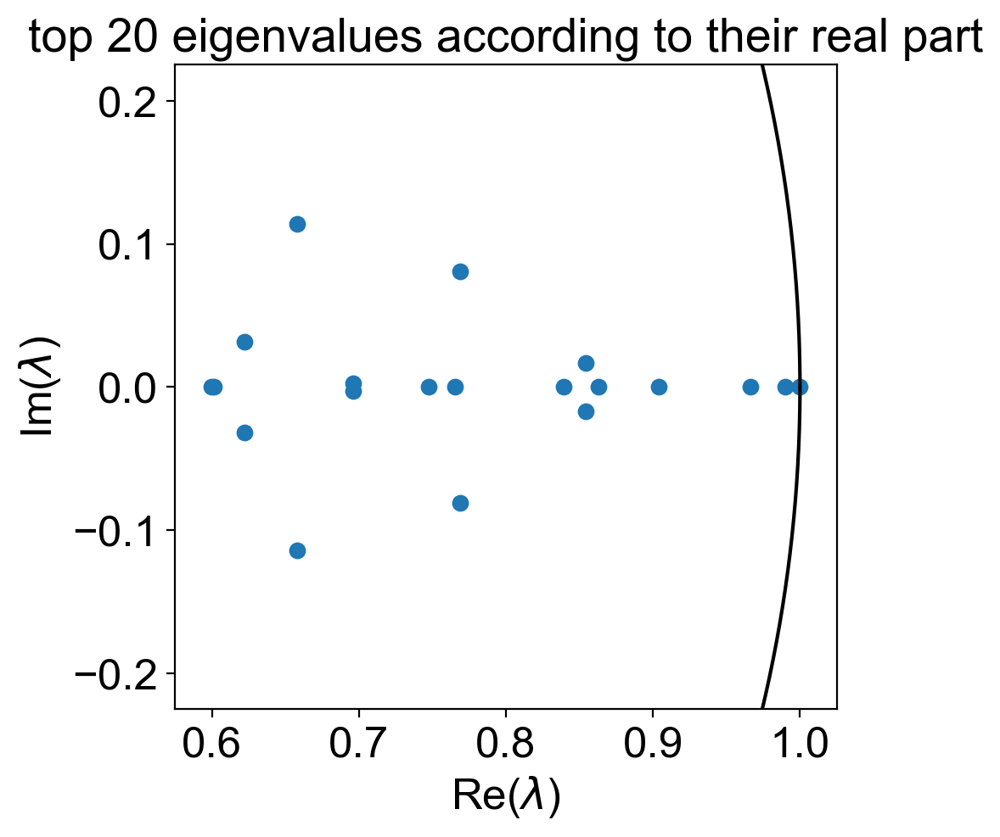

In [31]:
g_fwd.compute_schur(n_components=20)

fig_kwargs = {'real_only': True, 'show_eigengap': False, 'show_all_xticks': False, 's': 150}
if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_spectrum/real_part.pdf' 
g_fwd.plot_spectrum(**fig_kwargs)

fig_kwargs = {'real_only': False, 's': 150}
if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_spectrum/complex_plane.pdf' 
g_fwd.plot_spectrum(**fig_kwargs)

## Show results for various numbers of macrostates

Computing `10` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:03)
saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_vary_n_states/n_states_10.pdf


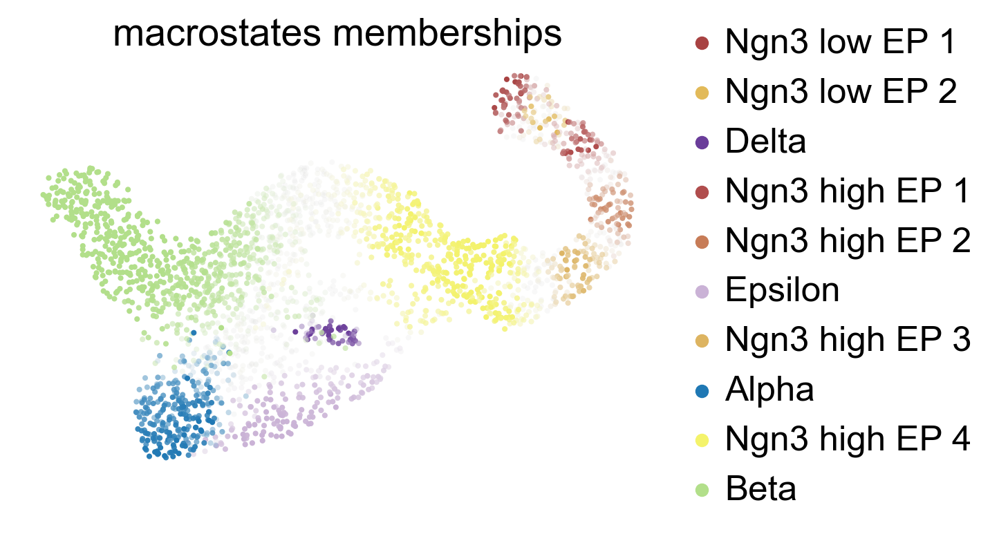

Computing `11` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:06)
saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_vary_n_states/n_states_11.pdf


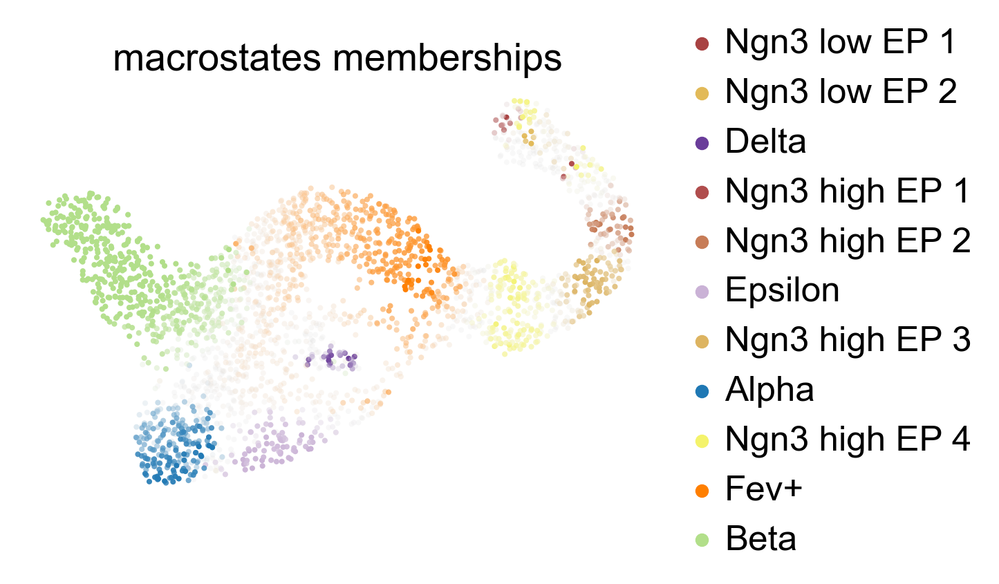

Computing `12` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:06)
saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_vary_n_states/n_states_12.pdf


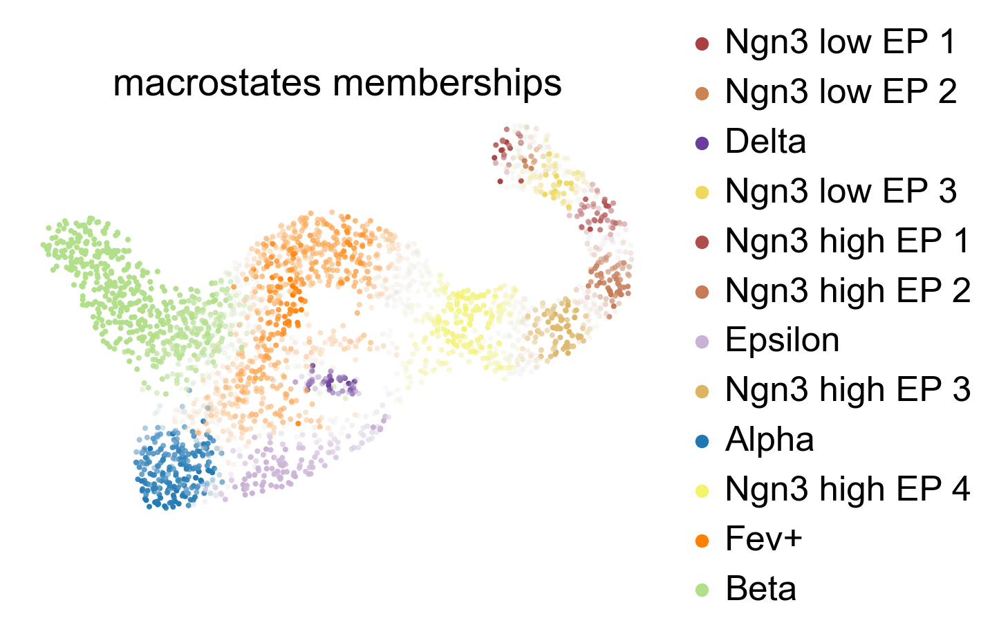

Computing `14` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:13)
saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_vary_n_states/n_states_14.pdf


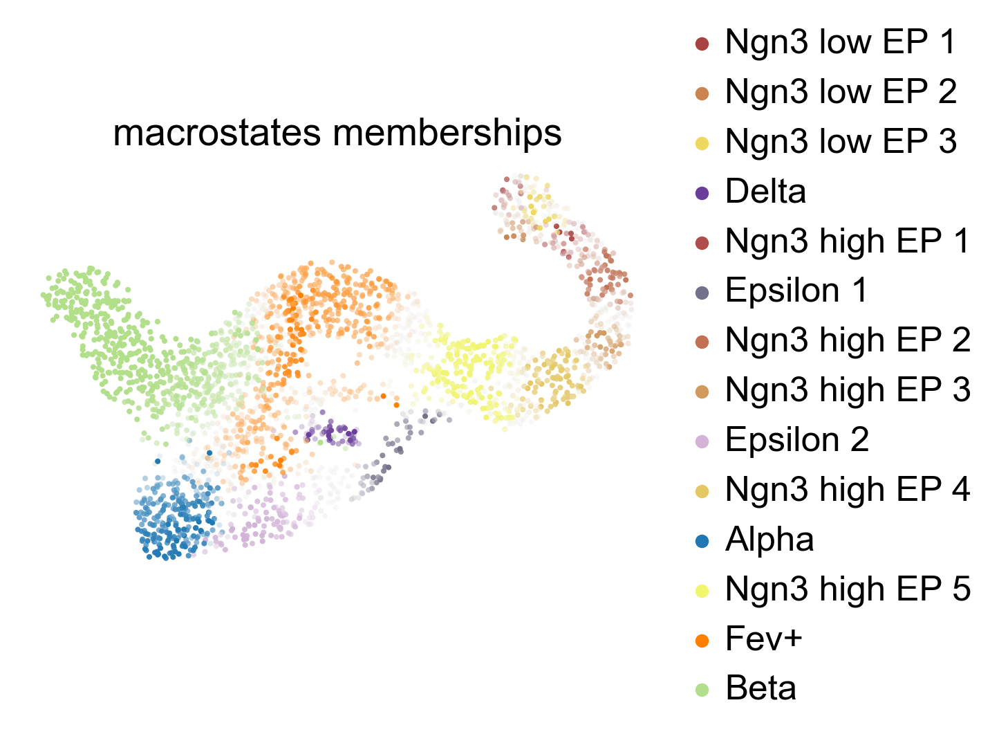

Computing `16` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:20)
saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_vary_n_states/n_states_16.pdf


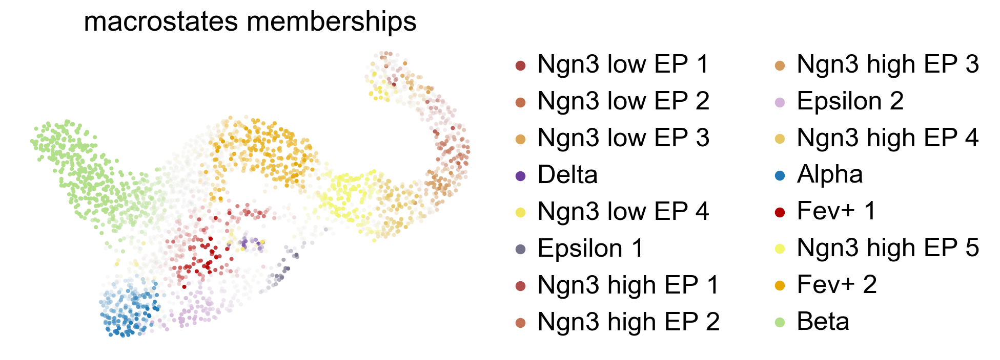

In [32]:
for n_states in [10, 11, 12, 14, 16]:

    g_fwd.compute_macrostates(cluster_key='clusters', n_states=n_states)

    fig_kwargs = {'legend_loc': 'right', 'discrete': False, 'dpi':100}
    if save_figure: fig_kwargs['save'] = scv.settings.figdir + f"suppl_figures_pancreas/suppl_fig_vary_n_states/n_states_{n_states}.pdf" 
    g_fwd.plot_macrostates(**fig_kwargs)

## Decompose dynamics into 12 macrostates

Computing `12` macrostates


/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:07)
saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/fig_2_pancreas_main/macrostates_umap.pdf


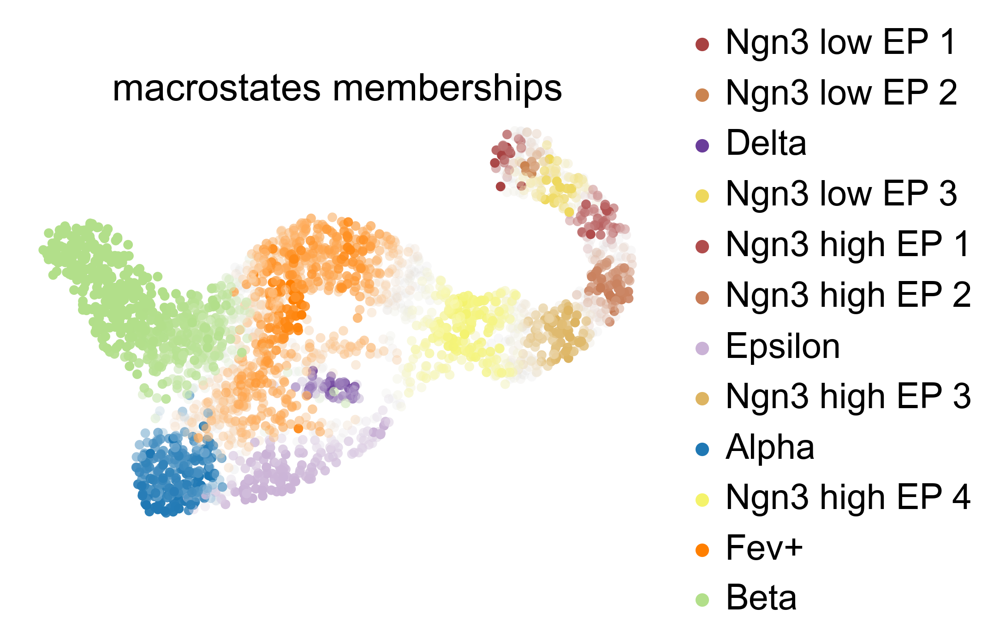

In [33]:
n_states = 12
g_fwd.compute_macrostates(cluster_key='clusters', n_states=n_states)

fig_kwargs = {'legend_loc': 'right', 'discrete': False, 'dpi':150, 'size': 100}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'fig_2_pancreas_main/macrostates_umap.pdf' 
g_fwd.plot_macrostates(**fig_kwargs)

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


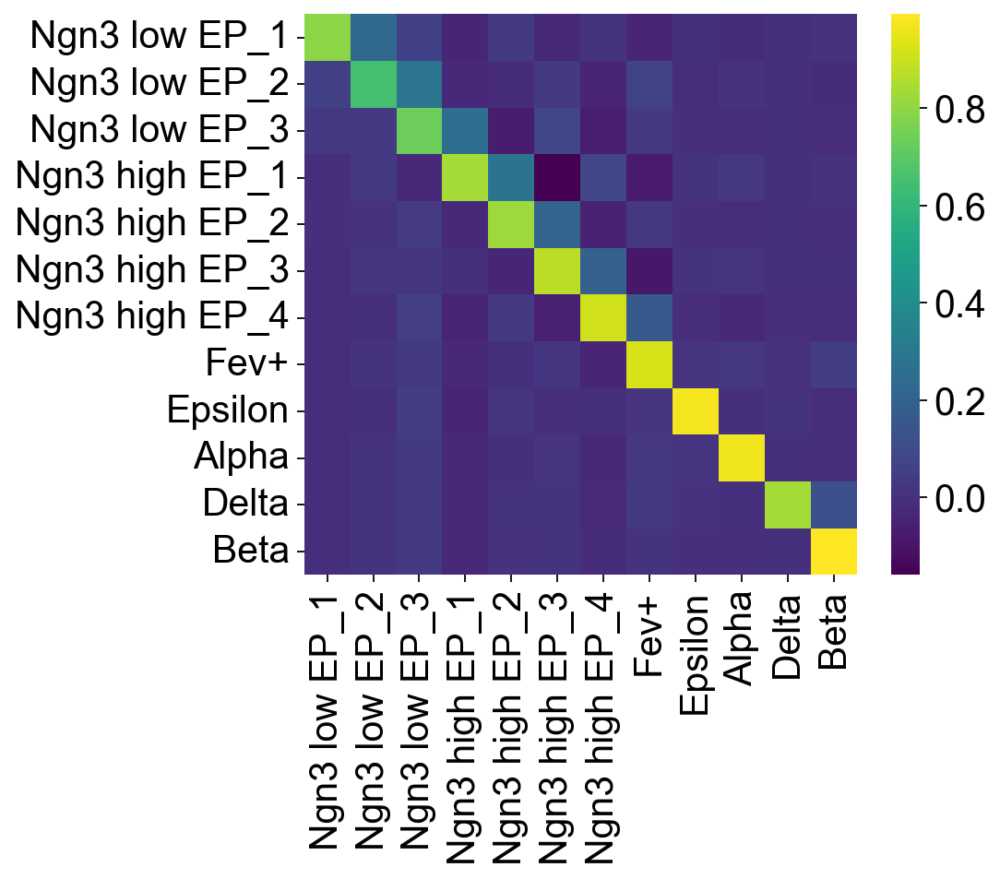

In [34]:
T_coarse = g_fwd.coarse_T
macro_names = ['Ngn3 low EP_1', 'Ngn3 low EP_2', 'Ngn3 low EP_3', 'Ngn3 high EP_1', 'Ngn3 high EP_2', 'Ngn3 high EP_3', 'Ngn3 high EP_4', 'Fev+', 'Epsilon', 'Alpha', 'Delta', 'Beta']

fig = plt.figure(None, (6, 5))
ax = fig.add_subplot(111)
sns.heatmap(T_coarse[macro_names].loc[macro_names], cmap='viridis', ax=ax)

if save_figure:
    plt.savefig(FIG_DIR / "fig_2_pancreas_main" / "t_coarse.pdf", bbox_inches='tight')

plt.show()

## Visualise the actual transition matrix

We want a visualisation of the transition matrix, where states are sorted according to their membership to macrostates. 

In [35]:
# get the transition matrix
T = adata.obsp['T_fwd'].A

# sort the cells by macrostate membership
macro_probs = g_fwd.macrostates_memberships[macro_names]
cell_assignment = macro_probs.argmax(1).X.flatten()

p = np.argsort(cell_assignment)
print(macro_probs.names)

['Ngn3 low EP_1' 'Ngn3 low EP_2' 'Ngn3 low EP_3' 'Ngn3 high EP_1'
 'Ngn3 high EP_2' 'Ngn3 high EP_3' 'Ngn3 high EP_4' 'Fev+' 'Epsilon'
 'Alpha' 'Delta' 'Beta']


/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Look at the distribution of non-zero values

<AxesSubplot:ylabel='Density'>

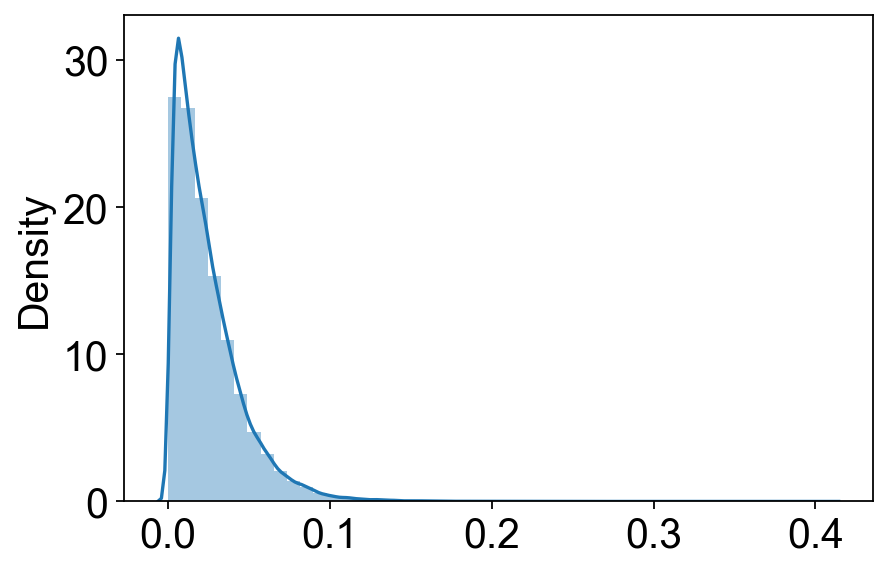

In [36]:
sns.distplot(T[T>0])

Plot the actual transition matrix

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


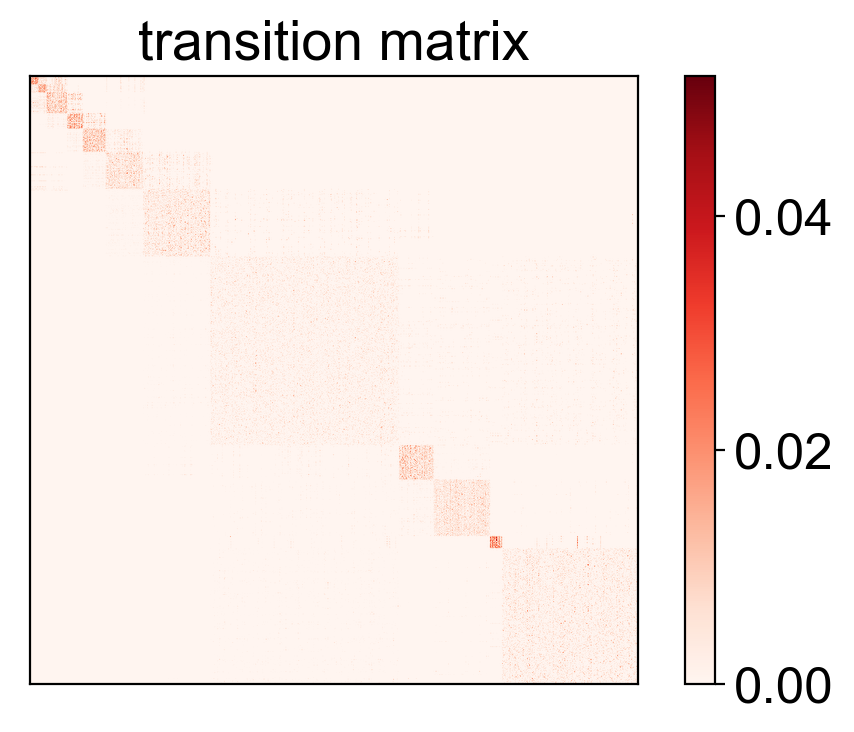

In [37]:
vmax = np.quantile(T[T>0], 0.90)

fig = plt.figure(None, dpi=100)
ax = fig.add_subplot(111)

cax = ax.imshow(T[p ,:][:, p], vmin=0, vmax=vmax, cmap='Reds', interpolation='sinc', filterrad=4.0)

ax.set_xticks([])
ax.set_yticks([])
ax.set_title('transition matrix')

plt.colorbar(mappable=cax)
if save_figure:
    plt.savefig(FIG_DIR / "suppl_figures_pancreas" / "suppl_fig_transition_matrix" / "t_sorted.pdf",
                bbox_inches='tight')
plt.show()

Same for the unsorted matrix to compare

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


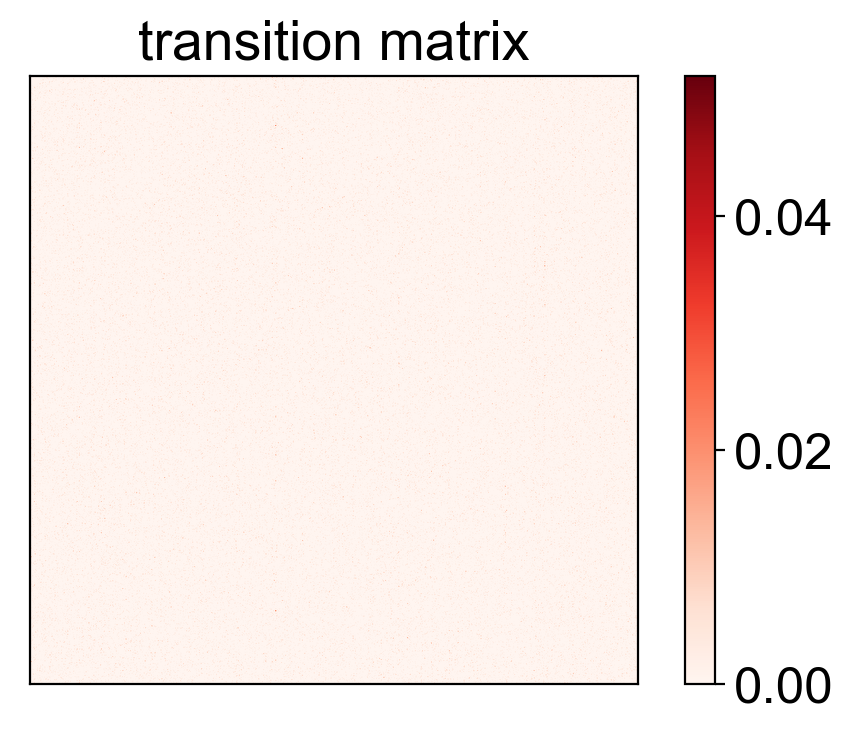

In [38]:
vmax = np.quantile(T[T>0], 0.90)

fig = plt.figure(None, dpi=100)
ax = fig.add_subplot(111)
cax = ax.imshow(T, vmin=0, vmax=vmax, cmap='Reds', interpolation='sinc', filterrad=4.0)

ax.set_xticks([])
ax.set_yticks([])
ax.set_title('transition matrix')

plt.colorbar(mappable=cax)
if save_figure:
    plt.savefig(FIG_DIR / "suppl_figures_pancreas" / "suppl_fig_transition_matrix" / "t_unsorted.pdf",
                bbox_inches='tight')
plt.show()

## Automatically identify initial and terminal states

Based on the coarse-grained transition matrix, automatically identify the terminal states of this system:

Adding `adata.obs['terminal_states']`
       `adata.obs['terminal_states_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


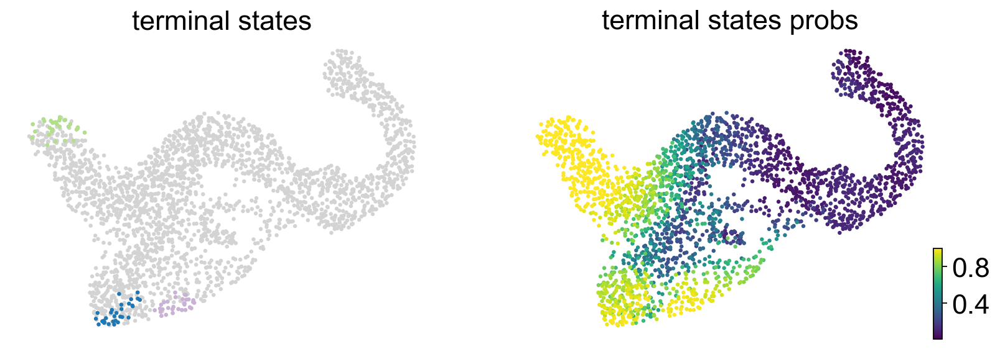

In [39]:
g_fwd.compute_terminal_states()
scv.pl.scatter(adata, c=['terminal_states', 'terminal_states_probs'], color_map='viridis')

We automatically found alpha, beta and epslion, consistent with known biology! However, we didn't capture the Delta state automatically - that's because it's very small (70) cells and splicing kinetics in that state fail to recolve the development (see our manuscript). None of the known Delta drivers are among them and for the actual drivers (Hhex, Cd24a), we don't have enough counts to reliably fit the phase portraits.  Therefore, we add the Delta state manually which is very simple in CellRank:

In [40]:
g_fwd.set_terminal_states_from_macrostates(names=['Alpha', 'Beta', 'Epsilon', 'Delta'])

Adding `adata.obs['terminal_states']`
       `adata.obs['terminal_states_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


For the initial states, we simply run

In [41]:
g_fwd._compute_initial_states()

Adding `adata.obs['initial_states']`
       `adata.obs['initial_states_colors']`



By default, this will compute a single initial state unless you tell it via `n_states` to compute more. We can check the identied state as well as the associated membership values:

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_pancreas/suppl_fig_palantir_pseudotime/initial_state.pdf


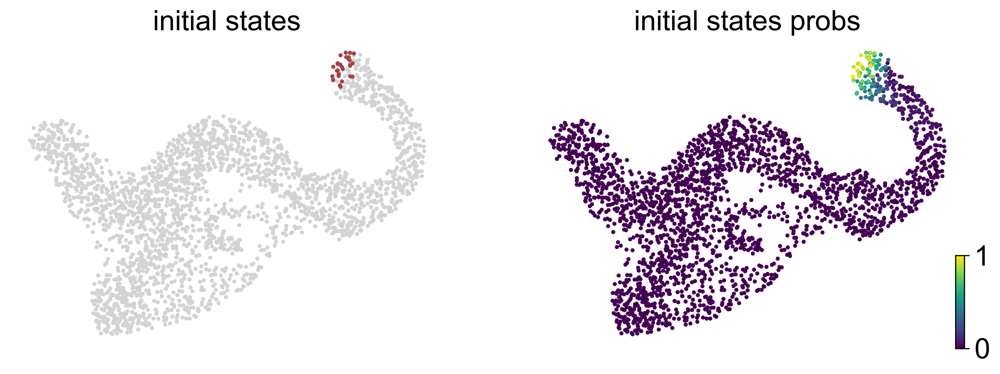

In [42]:
fig_kwargs = {'color':['initial_states', 'initial_states_probs'], 'color_map': 'viridis', 'dpi': 150}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'suppl_figures_pancreas/suppl_fig_palantir_pseudotime/initial_state.pdf' 
scv.pl.scatter(adata, **fig_kwargs)

## Aggregate initial and terminal states

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/fig_2_pancreas_main/initial_terminal.pdf


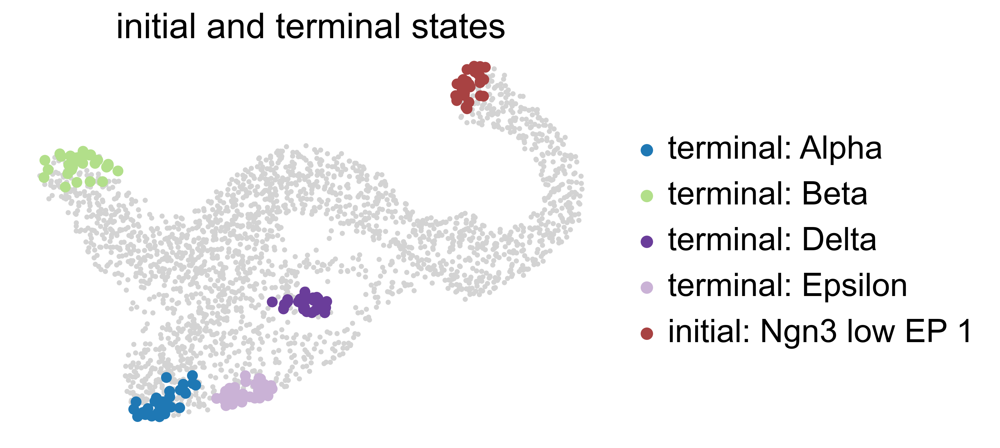

In [43]:
_create_initial_terminal_annotations(adata)

figure_params = {'title': f'initial and terminal states', 'legend_loc': 'right', 'dpi': 200, 
                 'color': 'initial_terminal', 's': 150}
if save_figure: figure_params['save'] = scv.settings.figdir + "fig_2_pancreas_main/initial_terminal.pdf"
scv.pl.scatter(adata, **figure_params)

## Compute and plot fate probabilities

In [44]:
g_fwd.compute_absorption_probabilities()

Computing absorption probabilities


/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


  0%|          | 0/4 [00:00<?, ?/s]

Adding `adata.obsm['to_terminal_states']`
       `.absorption_probabilities`
    Finish (0:00:00)


saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/fig_2_pancreas_main/fate_probabilities.pdf


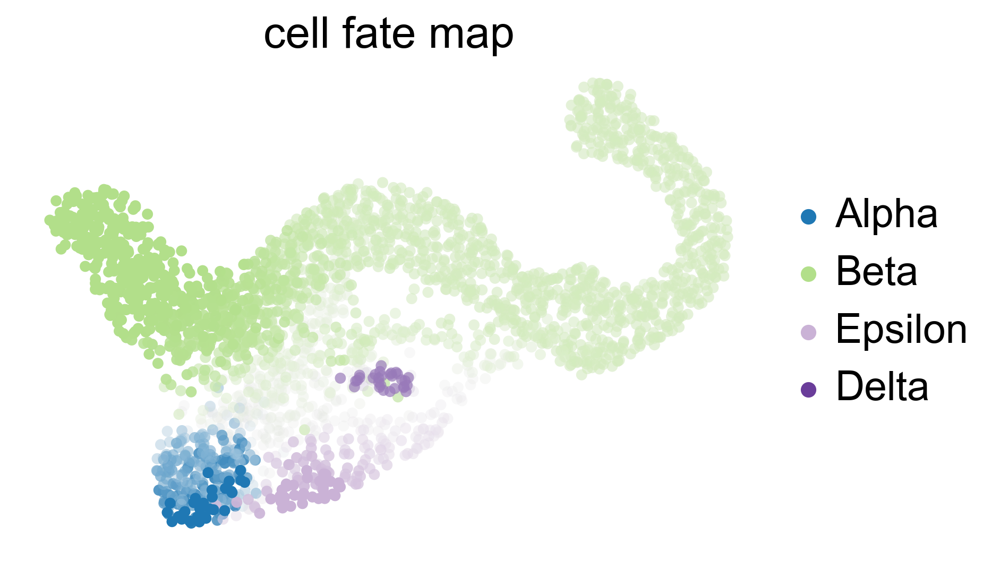

In [45]:
figure_kwargs = {'title': f'cell fate map', 'dpi': 150, 'same_plot': True, 'size': 100, 'legend_loc': 'right'}
if save_figure: figure_kwargs['save'] = scv.settings.figdir + "fig_2_pancreas_main/fate_probabilities.pdf"
g_fwd.plot_absorption_probabilities(**figure_kwargs)

## Aggregate fate probabilities to cluster level

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


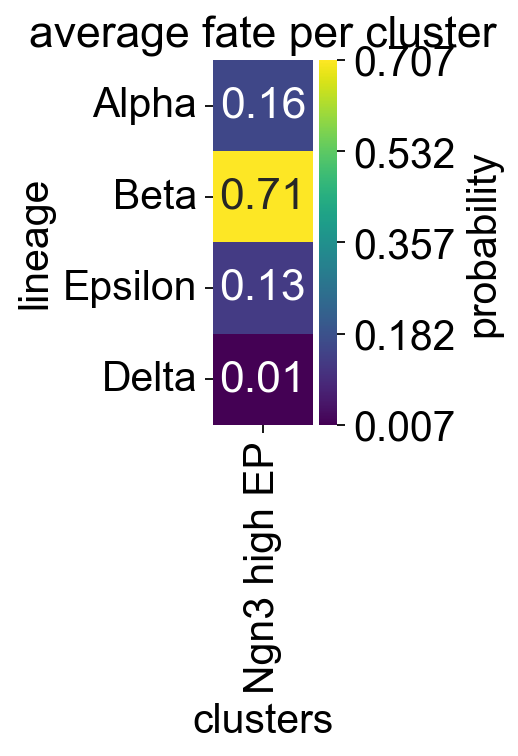

In [46]:
figure_kwargs = {'cluster_key': 'clusters', 
                 'mode': 'heatmap', 
                'lineages': ['Alpha', 'Beta', 'Epsilon', 'Delta'],
                 'clusters': ['Ngn3 high EP'], 'figsize': (1, 3)}
if save_figure: figure_kwargs['save'] = 'fig_2_pancreas_main/ngn3_high_fate_probs.pdf'
cr.pl.cluster_fates(adata, **figure_kwargs)

# Visualise gene expression trends

## Prepare for gene trend plotting

Set global gene-trend fitting parameters:

In [47]:
pseudotime = 'palantir_pseudotime'
data_key = 'magic_imputed_data'

# pyGAM settings
n_knots = 10
weight_threshold = (0.05, 0.05)

# mgcv settings
n_knots_mgcv = 6
weight_threshold_mgcv = (1e-3, 1e-3)
smoothing_penalty_mgcv = 10.0

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


For plotting, use the raw anndata object. Copy over the lineage probabilities. 

In [48]:
adata_raw.obsm['to_terminal_states'] = adata.obsm['to_terminal_states'].copy()
adata_raw.uns['terminal_states_colors'] = adata.uns['terminal_states_colors'].copy()
# adata_raw.uns['to_terminal_states_colors'] = adata.uns['to_terminal_states_colors'].copy()

Check the initial and terminal state identification wich will be used to initialise latent time. 

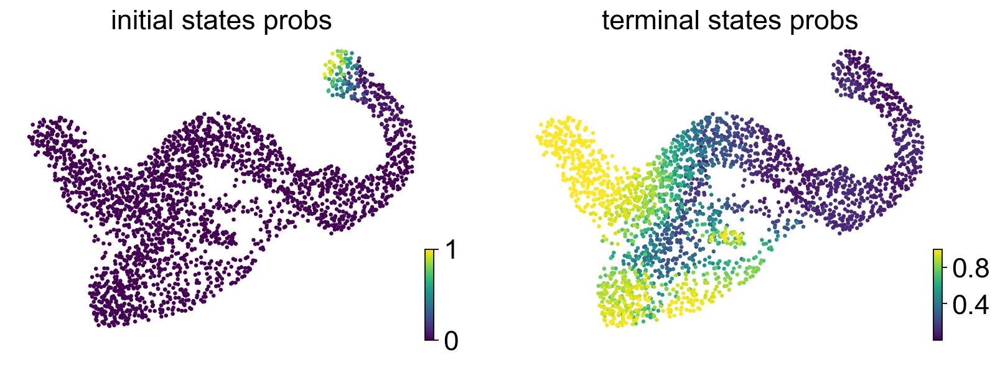

In [49]:
scv.pl.scatter(adata, color=['initial_states_probs', 'terminal_states_probs'], color_map='viridis')

Compute latent time

computing latent time using initial_states_probs, terminal_states_probs as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)


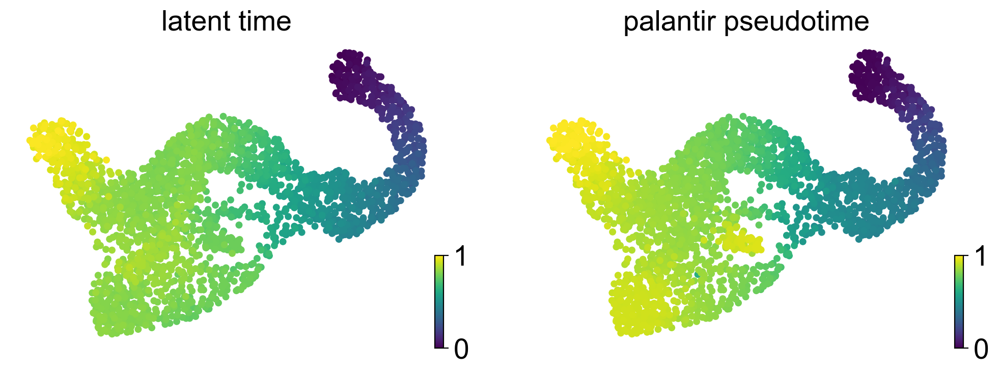

In [50]:
scv.tl.recover_latent_time(adata, root_key='initial_states_probs', end_key='terminal_states_probs')

# copy latent time over into the raw anndata object
adata_raw.obs['latent_time'] = adata.obs['latent_time'].copy()

scv.pl.scatter(adata_raw, color=['latent_time', 'palantir_pseudotime'], color_map='viridis', dpi=100, size=100)

## Visualise fate probabilities in directed PAGA

In [51]:
if 'paga' in adata.uns.keys():
    del adata.uns['paga']
scv.tl.paga(adata, groups='clusters', root_key='initial_states_probs', end_key='terminal_states_probs', 
            use_time_prior='velocity_pseudotime')

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


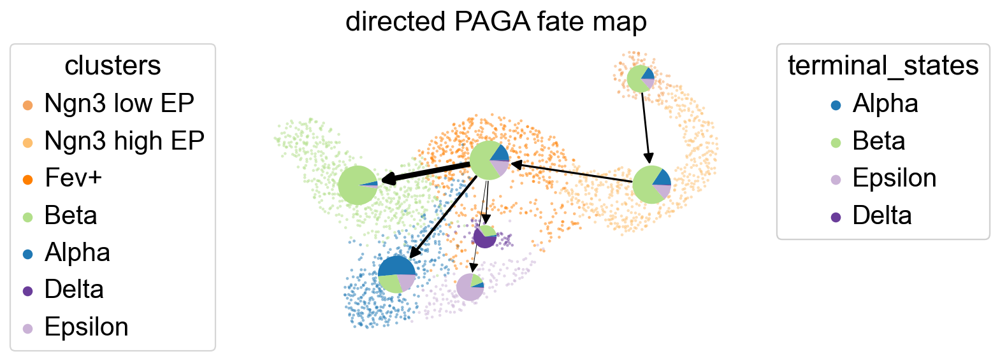

In [52]:
fig_kwargs = {'cluster_key': 'clusters', 
                 'mode':'paga_pie', 
                 'basis':'umap', 
                 'dashed_edges': None,
                 'legend_kwargs':{'loc':'top right out'}, 
                 'legend_loc':'top left out', 
                 'node_size_scale':5, 
                 'edge_width_scale':1, 
                 'max_edge_width':4, 
                 'title': f'directed PAGA fate map'}

if save_figure: fig_kwargs['save'] = 'suppl_figures_pancreas/suppl_fig_paga/directed_paga.png'
cr.pl.cluster_fates(adata, **fig_kwargs)

## Visualise gene exp. trends (Fig. 2)

Plot for the pancres figure

In [53]:
fig_2_genes = ['Arx', 'Pdx1', 'Irs4', 'Hhex']

Computing trends using `1` core(s)


  0%|          | 0/4 [00:00<?, ?gene/s]

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/rpy2/robjects/pandas2ri.py:261: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '
/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/rpy2/robjects/numpy2ri.py:195: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '


    Finish (0:00:00)
Plotting trends


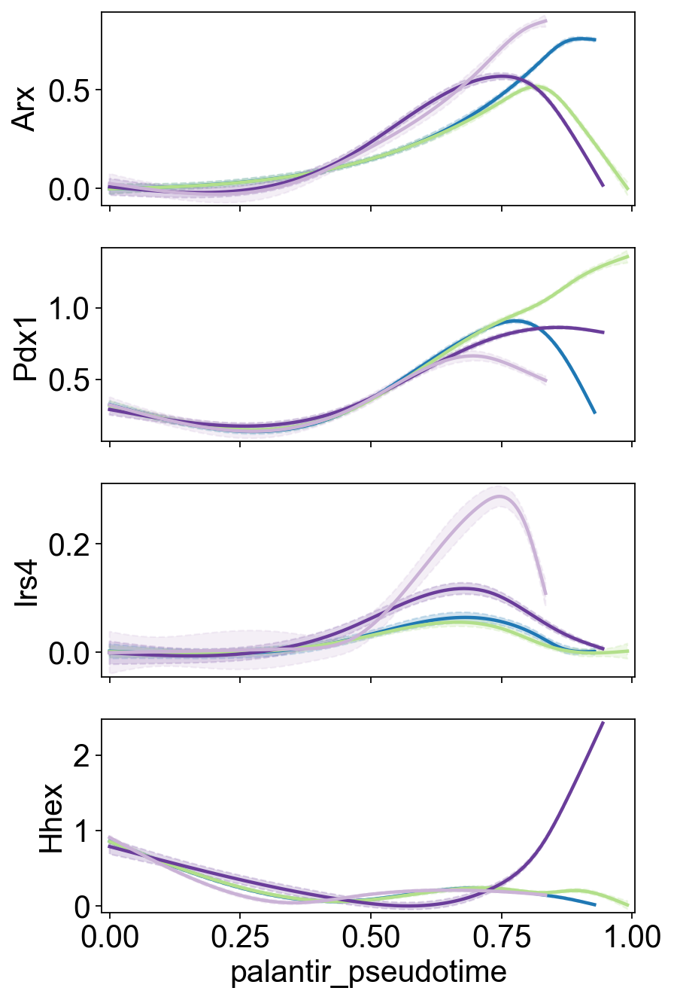

In [54]:
# using mgcv
model = cr.ul.models.GAMR(adata_raw, n_knots=n_knots_mgcv, smoothing_penalty=smoothing_penalty_mgcv)
    

fig_kwargs = {'model': model,
              'data_key': data_key, 
              'gene_as_title': False, 
              'legend_loc': None,
              'genes': fig_2_genes, 
              'ncols': 1,
              'time_key': pseudotime, 
              'same_plot': True, 
              'hide_cells': True,
              'weight_threshold': weight_threshold_mgcv, 
              'figsize': (6, 9), 
              'suptitle': ''}

if save_figure: fig_kwargs['save'] = 'fig_2_pancreas_main/gene_trends_mgcv.pdf'

cr.pl.gene_trends(adata_raw, **fig_kwargs)

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/fig_2_pancreas_main/gene_expression_umap.pdf


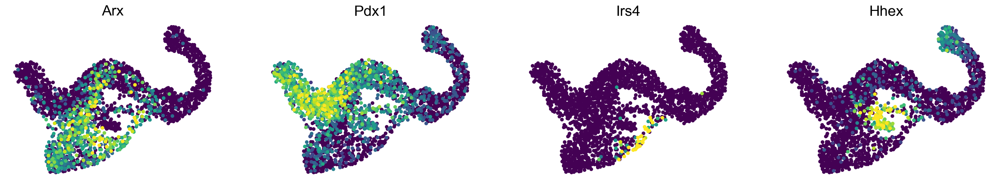

In [55]:
fig_kwargs = {'color': fig_2_genes, 'perc': [0, 99], 'title': fig_2_genes, 'size': 100, 'colorbar': False}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'fig_2_pancreas_main/gene_expression_umap.pdf'
scv.pl.scatter(adata_raw, **fig_kwargs)

## Visualise gene exp. trends (Fig. 5)

Computing trends using `1` core(s)


/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


  0%|          | 0/1 [00:00<?, ?gene/s]

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/rpy2/robjects/pandas2ri.py:261: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '
/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/rpy2/robjects/numpy2ri.py:195: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '


    Finish (0:00:00)
Plotting trends


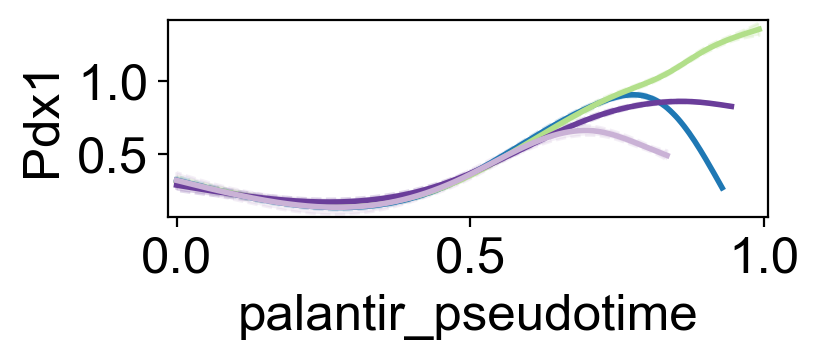

In [56]:
# using mgcv
model = cr.ul.models.GAMR(adata_raw, n_knots=n_knots_mgcv, smoothing_penalty=smoothing_penalty_mgcv)

fig_kwargs = {'model': model,
              'data_key': data_key, 
              'gene_as_title': False, 
              'legend_loc': None,
              'genes': ['Pdx1'],
              'ncols': 1,
              'dpi': 100,
              'time_key': pseudotime, 
              'same_plot': True, 
              'hide_cells': True,
              'weight_threshold': weight_threshold_mgcv, 
              'figsize': (4.5, 2.5), 
              'suptitle': ''}

if save_figure: fig_kwargs['save'] = 'fig_5_benchmarking/cellrank/gene_trend_pdx1_mgcv.pdf'

cr.pl.gene_trends(adata_raw, **fig_kwargs)

## Visualise gene expression trends (supplement)

In [57]:
suppl_genes = ['Pax4', 'Pdx1', 'Arx', 'Peg10', 'Irs4', 'Ghrl', 'Hhex', 'Cd24a']

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Computing trends using `1` core(s)


  0%|          | 0/8 [00:00<?, ?gene/s]

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/rpy2/robjects/pandas2ri.py:261: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '
/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/rpy2/robjects/numpy2ri.py:195: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '


    Finish (0:00:01)
Plotting trends


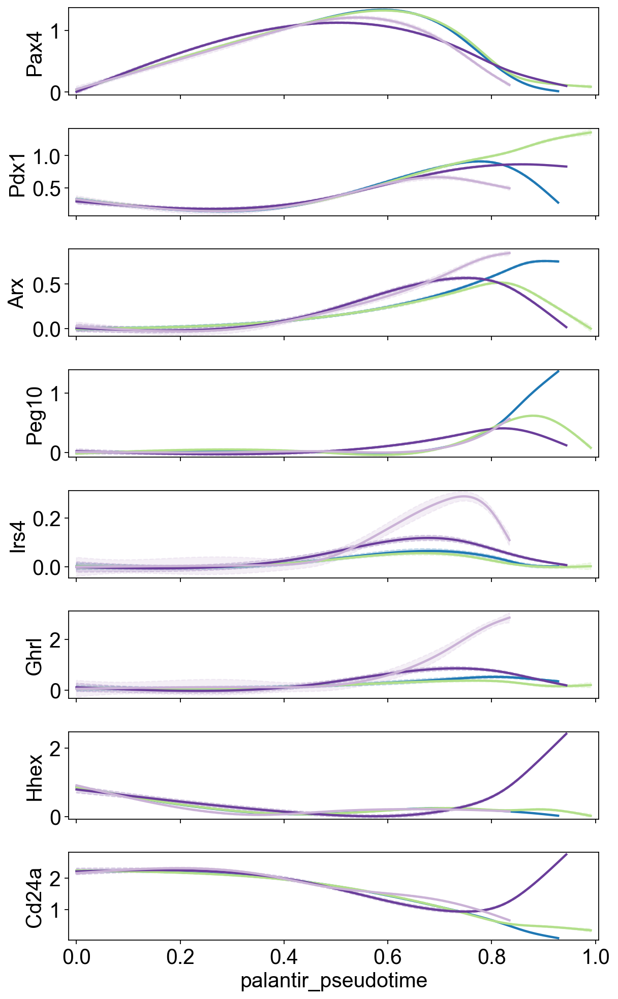

In [58]:
# using mgcv
model = cr.ul.models.GAMR(adata_raw, n_knots=n_knots_mgcv, smoothing_penalty=smoothing_penalty_mgcv)

fig_kwargs = {'model': model,
              'data_key': data_key, 
              'gene_as_title': False, 
              'legend_loc': None,
              'genes': suppl_genes,
              'ncols': 1,
              'time_key': pseudotime, 
              'same_plot': True, 
              'hide_cells': True,
              'weight_threshold': weight_threshold_mgcv, 
              'figsize': (8, 13), 
              'suptitle': ''}

if save_figure: fig_kwargs['save'] = 'suppl_figures_gene_trends/cellrank_mgcv.pdf'

cr.pl.gene_trends(adata_raw, **fig_kwargs)

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_gene_trends/gene_expression_0_to_4.pdf


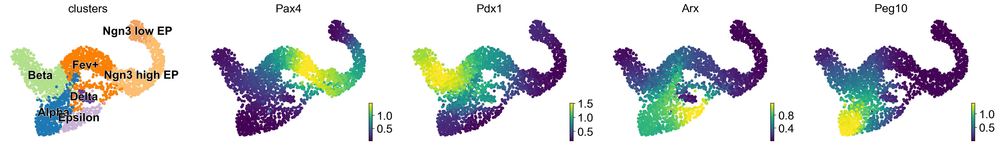

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/suppl_figures_gene_trends/gene_expression_4_to_8.pdf


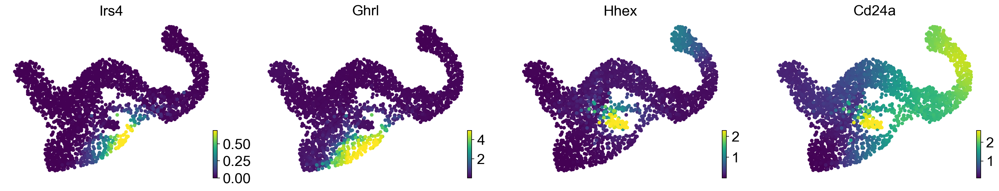

In [59]:
fig_kwargs = {'color': ['clusters'] + suppl_genes[:4], 'layer': data_key, 'title': ['clusters'] + suppl_genes[:4], 
             'perc': [0, 99], 'legend_loc': 'on data', 'size': 100}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'suppl_figures_gene_trends/gene_expression_0_to_4.pdf'
scv.pl.scatter(adata_raw, **fig_kwargs)

fig_kwargs = {'color': suppl_genes[4:], 'layer': data_key, 'title': suppl_genes[4:], 
             'perc': [0, 99], 'legend_loc': 'on data', 'size': 100}
if save_figure: fig_kwargs['save'] = scv.settings.figdir +'suppl_figures_gene_trends/gene_expression_4_to_8.pdf'
scv.pl.scatter(adata_raw, **fig_kwargs)

# Look into delta cell differentiation (Fig. 3)

## Visualise and compare fate probabilities

Compute lineage drivers towards the Delta lineage

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/fig_3_pancreas_delta/fate_probabilities.pdf


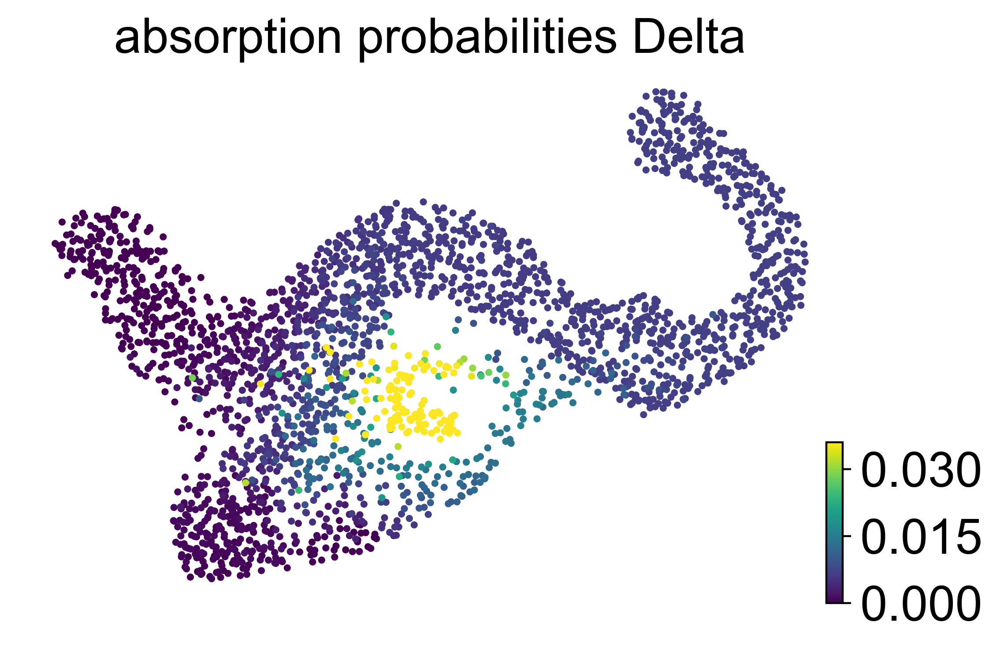

In [60]:
fig_kwargs = {'same_plot': False, 'perc': [0, 96], 'dpi': 200, 'states': ['Delta']}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'fig_3_pancreas_delta/fate_probabilities.pdf'
g_fwd.plot_absorption_probabilities(**fig_kwargs)

Show and quantify lineage bias towards Delta

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


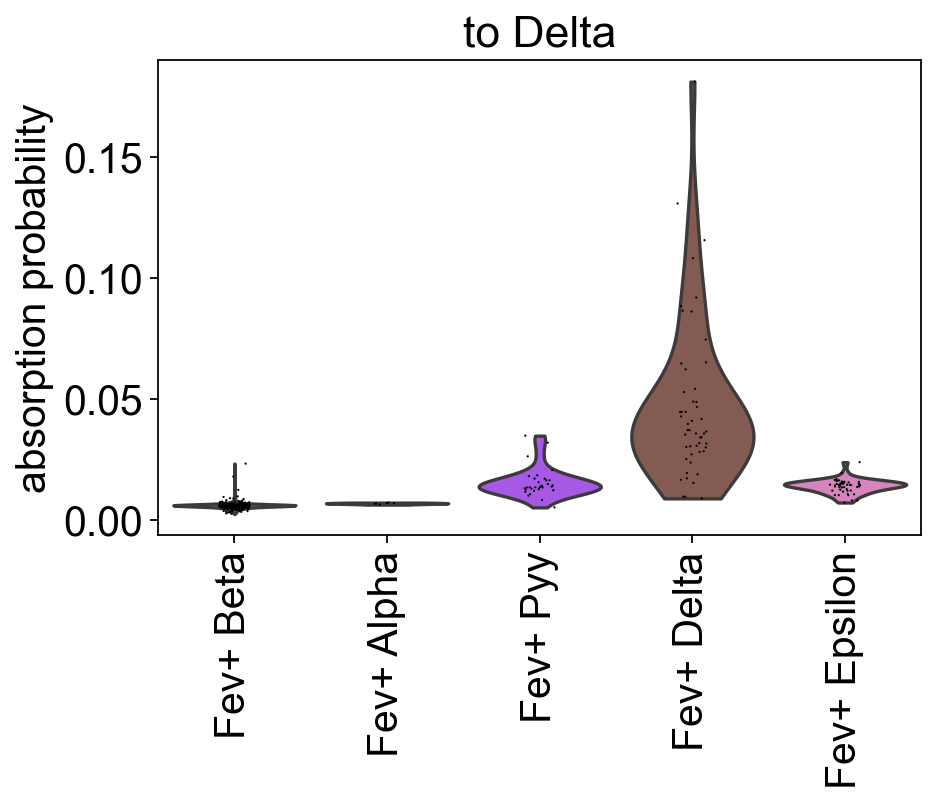

In [61]:
fev_clusters = ['Fev+ Beta', 'Fev+ Alpha', 'Fev+ Delta', 'Fev+ Epsilon', 'Fev+ Pyy']
fig_kwargs = {'mode': 'violin', 'lineages': ['Delta'], 'cluster_key': 'clusters_fine', 'clusters': fev_clusters}
if save_figure: fig_kwargs['save'] = 'fig_3_pancreas_delta/violin_fate_probs_fev_clusters.pdf'
cr.pl.cluster_fates(adata, **fig_kwargs)

Perform two-sided Welch's t-test (not assuming equal variances) to show that the Fev+ Delta cluster is assigned highest Delta probabilities by CellRank:

In [62]:
from scipy.stats import ttest_ind

fate_probs = g_fwd.absorption_probabilities['Delta']
mask_background = np.in1d(adata.obs['clusters_fine'], ['Fev+ Beta', 'Fev+ Alpha', 'Fev+ Epsilon', 'Fev+ Pyy'])
mask_target = np.in1d(adata.obs['clusters_fine'], ['Fev+ Delta'])

background = fate_probs[mask_background]
target = fate_probs[mask_target]
print(f"There are {np.sum(mask_background)} cell in the background and {np.sum(mask_target)} cell in the target.")

ttest_ind(target, background, equal_var=False)

There are 536 cell in the background and 51 cell in the target.


/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Ttest_indResult(statistic=array([8.63586063]), pvalue=array([1.7231595e-11]))

## Show potential lineage drivers in heatmap

Compute potential lineage drivers through correlating gene expression with fate probabilities:

In [63]:
g_fwd.compute_lineage_drivers(lineages=['Delta'], cluster_key='clusters', clusters=['Fev+'], 
                              use_raw=True)
delta_corr = adata.raw.varm['terminal_lineage_drivers'].sort_values(by='Delta_corr', ascending=False)
delta_corr = delta_corr.head(50)
print(f"Selected {len(delta_corr)} genes")

Adding `adata.raw.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:00)
Selected 50 genes


Plot the gene expression trends as a heatmap

Computing trends using `1` core(s)


/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


  0%|          | 0/50 [00:00<?, ?gene/s]

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/rpy2/robjects/pandas2ri.py:261: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '
/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/rpy2/robjects/numpy2ri.py:195: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '


    Finish (0:00:01)


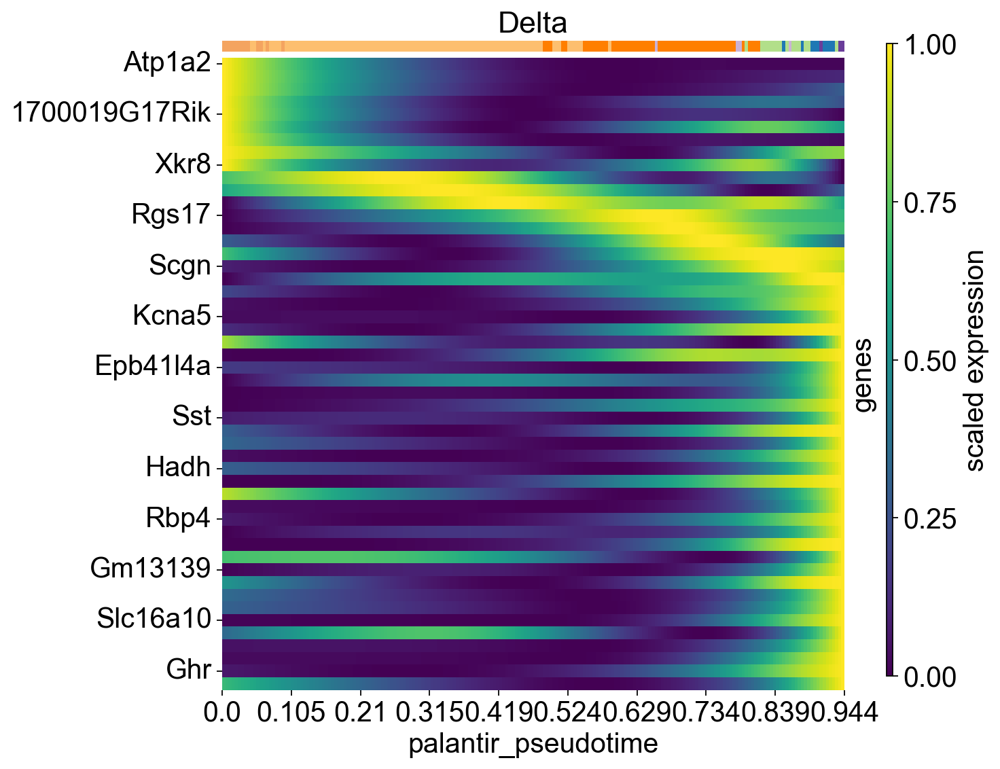

In [64]:
# using mgcv
model = cr.ul.models.GAMR(adata_raw, n_knots=n_knots_mgcv, smoothing_penalty=smoothing_penalty_mgcv)
fig_kwargs = {'model': model, 
              'genes': delta_corr.index, 
              'lineages': ['Delta'], 
              'cluster_key': 'clusters', 
              'data_key': data_key, 
              'time_key': pseudotime, 
              'show_absorption_probabilities': False, 
              'figsize': (10, 8), 
              'show_all_genes': False, 
              'weight_threshold': weight_threshold_mgcv}

if save_figure: fig_kwargs['save'] = 'fig_3_pancreas_delta/heatmap_small_mgcv.pdf'
    
cr.pl.heatmap(adata_raw, **fig_kwargs) 

Plot an extended version with all gene names included:

Computing trends using `1` core(s)


/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


  0%|          | 0/50 [00:00<?, ?gene/s]

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/rpy2/robjects/pandas2ri.py:261: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '
/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/rpy2/robjects/numpy2ri.py:195: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '


    Finish (0:00:02)


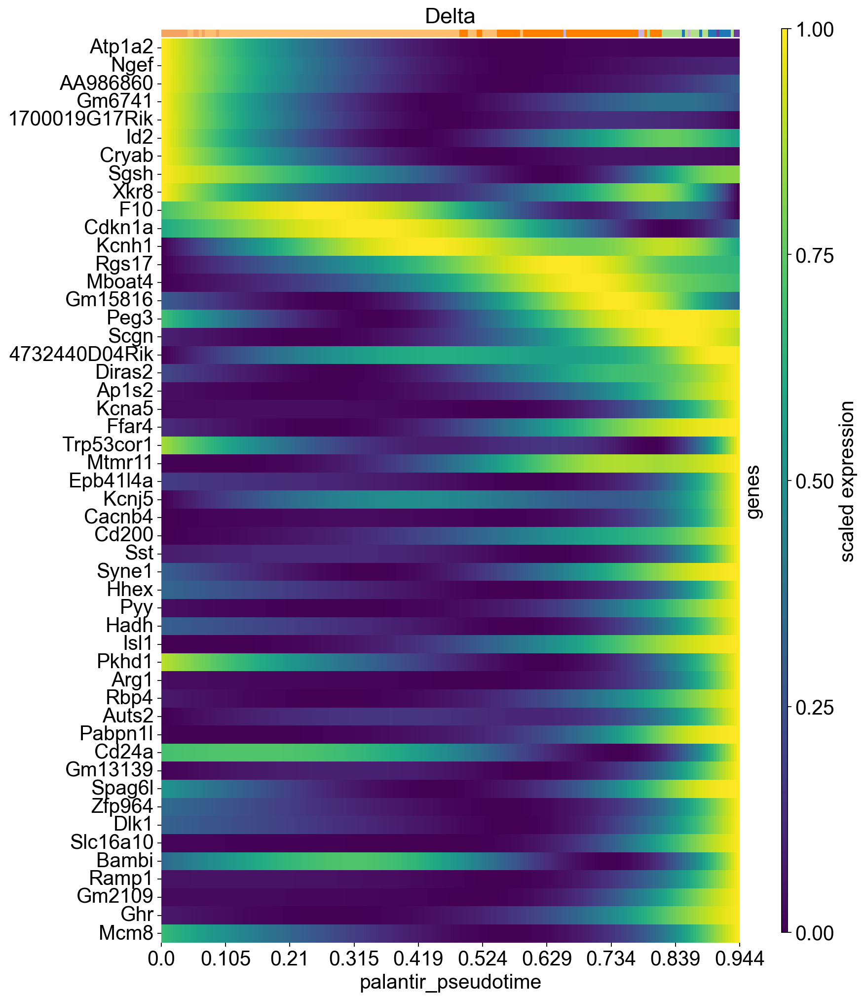

In [65]:
# using mgcv
model = cr.ul.models.GAMR(adata_raw, n_knots=n_knots_mgcv, smoothing_penalty=smoothing_penalty_mgcv)
fig_kwargs = {'model': model, 
              'genes': delta_corr.index, 
              'lineages': ['Delta'], 
              'cluster_key': 'clusters', 
              'data_key': data_key, 
              'time_key': pseudotime, 
              'show_absorption_probabilities': False, 
              'figsize': (12, 15), 
              'show_all_genes': True, 
              'weight_threshold': weight_threshold_mgcv}
if save_figure: fig_kwargs['save'] = 'fig_3_pancreas_delta/heatmap_large_mgcv.pdf'
    
cr.pl.heatmap(adata_raw, **fig_kwargs)  

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/fig_3_pancreas_delta/known_genes.pdf


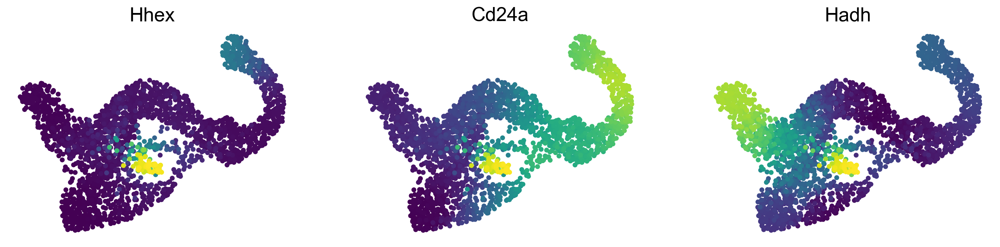

In [66]:
delta_genes = ['Hhex', 'Cd24a', 'Hadh']
fig_kwargs = {'color': delta_genes, 'size': 100, 'layer': 'magic_imputed_data', 'title': delta_genes, 
             'dpi': 100, 'colorbar': False,}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'fig_3_pancreas_delta/known_genes.pdf'
scv.pl.scatter(adata_raw, **fig_kwargs)

## Cluster trends towards the delta fate

Next, we want to cluster gene expression trends along the Delta lineage. There is no caching for this in scachepy, so we do it manually becasue this usually takes around 6 min (on a laptop). The downside of this caching is that you only get the plot if you recompute - so recompute if you're reproducing paper figures!

In [67]:
# set up the model, set parameters
model = cr.ul.models.GAM(adata_raw, n_knots=n_knots)
gene_cluster_kwargs = {'model': model, 
                       'genes': adata_raw.var_names, 
                       'lineage': 'Delta', 
                       'time_key': pseudotime, 
                       'n_jobs': 8, 
                       'data_key': data_key, 
                       'recompute': True, 
                       'random_state': 0, 
                       'weight_threshold': weight_threshold, 
                       'clustering_kwargs': {'resolution': 0.2, 'random_state': 0},
                       'neighbors_kwargs': {'random_state': 0}}


# define caching file (can't use scachepy here, not implemented)
gene_cluster_cache = CACHE_DIR / "pancreas" / "tl" / "2021-09-21_gene_trend_clusters.h5ad"

# check whether we want to use caching and if yes, whether to recompute
if use_caching:
    if force_recompute:
        print('Recomputing (forced)')
        cr.pl.cluster_lineage(adata_raw, **gene_cluster_kwargs)
        gdata = adata_raw.uns['lineage_Delta_trend'].copy()
        gdata.write(gene_cluster_cache, compression='gzip')
        print('Written the data to file')
    else:
        try:
            gdata = sc.read(gene_cluster_cache)  
            print('Reading the data from file')
        except OSError:
            print('Recomputing (cache file not found)')
            cr.pl.cluster_lineage(adata_raw, **gene_cluster_kwargs)
            gdata = adata_raw.uns['lineage_Delta_trend'].copy()
            gdata.write(gene_cluster_cache, compression='gzip')
            print('Written the data to file')
else:    
    cr.pl.cluster_lineage(adata_raw, **gene_cluster_kwargs)
    gdata = adata_raw.uns['lineage_Delta_trend'].copy()

Reading the data from file


/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Select the cluster of transiently upregulated genes

In [68]:
gene_clusters = ['1'] 

mask = np.in1d(gdata.obs['clusters'], gene_clusters)
gene_df = gdata[mask].obs

Let's rank these genes according to their correlation with Delta fate probs

In [69]:
# re-compute linege drivers, using also the earlier clusters
g_fwd.compute_lineage_drivers(lineages=['Delta'], cluster_key='clusters', 
                              clusters=['Fev+'], use_raw=True)

gene_df = gene_df.join(adata.raw.varm['terminal_lineage_drivers'])
gene_df = gene_df.sort_values(by='Delta_corr', ascending=False)
gene_df.head(10)

Adding `adata.raw.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:00)


,clusters,Delta_corr,Delta_pval,Delta_qval,Delta_ci_low,Delta_ci_high
Kcnh1,1,0.274938,9.127868e-12,NaN,0.198427,0.348119
Rgs17,1,0.274571,9.758178e-12,NaN,0.198045,0.347770
Mboat4,1,0.263552,6.893548e-11,NaN,0.186606,0.337285
4732440D04Rik,1,0.240237,3.193686e-09,NaN,0.162469,0.315039
Tmem184c,1,0.202765,6.733659e-07,NaN,0.123871,0.279111
Nefl,1,0.197443,1.331943e-06,NaN,0.118409,0.273992
Mreg,1,0.187623,4.465116e-06,NaN,0.108341,0.264533
Ophn1,1,0.186953,4.837749e-06,NaN,0.107656,0.263888
Casp9,1,0.174395,2.062962e-05,NaN,0.094806,0.251768
Pla2g2f,1,0.161954,7.861812e-05,NaN,0.082104,0.239739


Focus on some interesting ones:

In [70]:
candidates = ['Map2k4', 'Msi1', 'Nefl']

/Users/marius/miniconda3/envs/cellrank/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Make sure these are actually among the top correlators:

In [71]:
{gene: np.where(np.in1d(gene_df.index, gene))[0][0] for gene in candidates}

{'Map2k4': 13, 'Msi1': 21, 'Nefl': 5}

Show their expression in the UMAP:

saving figure to file /Users/marius/Projects/cellrank_reproducibility_2/figures/fig_3_pancreas_delta/candidate_drivers.pdf


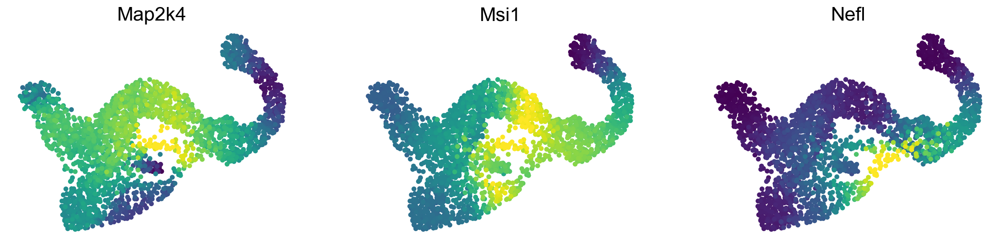

In [72]:
fig_kwargs = {'color': candidates, 'layer': data_key, 'title': candidates, 'colorbar': False, 'size': 100, 
             'perc': [0, 99]}
if save_figure: fig_kwargs['save'] = scv.settings.figdir + 'fig_3_pancreas_delta/candidate_drivers.pdf'
scv.pl.scatter(adata_raw, **fig_kwargs)